# Neural Networks and Deep Learning

University of Tehran

Author: Mohammad Taha Majlesi — Student ID: 810101504


# Neural Networks and Deep Learning
## CAe - Question 2

**Table of contents**<a id='toc0_'></a>    
- [Neural Networks and Deep Learning](#toc1_)    
  - [CAe - Question 2](#toc1_1_)    
- [Prepare the dataset](#toc2_)    
  - [Load the dataset](#toc2_1_)    
  - [Preprocess the captions](#toc2_2_)    
  - [Create Tokenizer](#toc2_3_)    
  - [Create the dataset](#toc2_4_)    
- [Create the model](#toc3_)    
  - [Encoder](#toc3_1_)    
  - [Decoder](#toc3_2_)    
  - [Model](#toc3_3_)    
- [Train the model](#toc4_)    
- [Scheduled Sampling](#toc5_)    
- [Scaled Dot-Product Attention](#toc6_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

**Libraries**

In [1]:
pip install arabic-reshaper python-bidi hazm torchinfo

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import torchvision.models as models
import matplotlib.pyplot as plt
from arabic_reshaper import ArabicReshaper
from bidi.algorithm import get_display
from collections import defaultdict
import re
from hazm import word_tokenize, Normalizer
import torch.nn as nn
import torch
from nltk.translate.bleu_score import corpus_bleu, SmoothingFunction
import pandas as pd
import torch.nn.functional as F
from torchinfo import summary
from torch.utils.data import DataLoader, Dataset
import os
np.random.seed(42)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# <a id='toc2_'></a>[Prepare the dataset](#toc0_)

## <a id='toc2_1_'></a>[Load the dataset](#toc0_)

In [4]:
!unzip -q -n '/content/drive/MyDrive/Colab/NNDL/CAe/Part2/Datasets/coco-flickr-fa-40k.zip' -d "/content/"

In [5]:
images_path = '/content/dataset/images'
len(os.listdir(images_path))

40000

In [ ]:
min_w = np.inf
min_h = np.inf
max_w = 0
max_h = 0
for filename in os.listdir(images_path):
    image_path = os.path.join(images_path, filename)
    with Image.open(image_path) as img:
        width, height = img.size
        min_w = min(min_w,width)
        min_h = min(min_h,height)
        max_w = max(max_w,width)
        max_h = max(max_h,height)

print("Min Width:",min_w,"Min Height:",min_h,"Max Width:",max_w,"Max Height:",max_h)

Min Width: 72 Min Height: 51 Max Width: 673 Max Height: 664


## <a id='toc2_2_'></a>[Preprocess the captions](#toc0_)

In [7]:
def preprocess_captions(path):
  file = open(path, "r")
  normalizer = Normalizer()
  captions = dict()
  emoji_pattern = re.compile("["
        u"\U0001F528-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           "]+", flags=re.UNICODE)

  lines = file.readlines()
  for line in lines[1:]:
      line = line.strip().split(",",1)
      if len(line) == 1:
        continue
      caption = line[1]
      caption = normalizer.normalize(caption)
      caption = emoji_pattern.sub(r'', caption)
      captions[line[0]]= caption

  file.close()
  return captions

In [ ]:
captions_path = os.path.join(images_path,'../data.csv')
captions = preprocess_captions(captions_path)
shuffled_keys = np.random.permutation(list(captions.keys()))

num_train = 10000
num_val = 500
num_test = 500

train_captions = dict({key: captions[key] for key in shuffled_keys[:num_train]})
val_captions = dict({key: captions[key] for key in shuffled_keys[num_train:num_val+num_train]})
test_captions = dict({key: captions[key] for key in shuffled_keys[num_val+num_train:num_val+num_train+num_test]})

## <a id='toc2_3_'></a>[Create Tokenizer](#toc0_)

In [9]:
class special_tokens:
  Start = "<sos>"
  End = "<eos>"
  Pad = "<pad>"
  Unknown = "<unk>"
  list_of_tokens = [Start,End,Pad,Unknown]

class Tokenizer():
  def __init__(self, captions,unknown_percent=0.1, dictionary=None):
    self.unknown_percent = unknown_percent
    self.unknown_words = []

    self.context_length = max(len(word_tokenize(caption)) for caption in captions.values())+2
    self.total_tokens = 0
    self.total_unknown_tokens = 0
    self.frequencies = defaultdict(int)

    if dictionary == None:
      self.dictionary = self._create_dictionary(captions.values())
    else:
      self.dictionary = dictionary

  def _create_dictionary(self,captions):
    dictionary = dict({token:i for i,token in enumerate(special_tokens.list_of_tokens)})

    for caption in captions:
      tokens = self.tokenize(caption)
      for token in tokens:
        self.frequencies[token] += 1
        self.total_tokens += 1

    self.frequencies = sorted(list(self.frequencies.items()), key=lambda x: x[1])
    freq_threshold = self.frequencies[int(self.unknown_percent*self.total_tokens)][1]
    for token, frequency in self.frequencies:
      if frequency <= freq_threshold:
        self.unknown_words.append((token, frequency))
        self.total_unknown_tokens += frequency
      else:
        dictionary[token] = len(dictionary)

    return dictionary

  def tokenize(self, text : str):
    return word_tokenize(text)

  def text_to_ids(self, text : str):
    tokens = self.tokenize(text)
    dictionary = self.dictionary
    ids = np.array([dictionary[special_tokens.Pad] for _ in range(self.context_length)])
    ids[0] = dictionary[special_tokens.Start]

    for i in range(1,min(self.context_length-1,len(tokens)+1)):
      token = tokens[i-1]
      if token in dictionary:
        ids[i] = dictionary[token]
      else:
        ids[i] = dictionary[special_tokens.Unknown]

    ids[min(len(tokens)+1,self.context_length-1)] = dictionary[special_tokens.End]
    return ids

  def ids_to_text(self, ids : list, ignore_special_tokens=False, end_with_eos = True):
      res = ""
      for id in ids:
        if end_with_eos and id == tokenizer.dictionary[special_tokens.End]:
          if ignore_special_tokens == False:
            res += list(self.dictionary.keys())[id]
          break
        if ignore_special_tokens and id < len(special_tokens.list_of_tokens):
          continue

        res += list(self.dictionary.keys())[id]
        res += " "

      return res.strip()

In [10]:
tokenizer = Tokenizer(train_captions,unknown_percent=0)
len_dictionary = len(tokenizer.dictionary)
unk_words = tokenizer.unknown_words
len_unk = len(unk_words)
total_tokens = tokenizer.total_tokens
total_unknown_tokens = tokenizer.total_unknown_tokens

print("Context length:",tokenizer.context_length)
print("Numer of unqiue tokens in captions:",len_dictionary+len_unk)
print("Numer of unqiue tokens in captions excluding unknown words:",len_dictionary)
print("Numer of unknown words in captions:",len_unk)
print("Percent of unknown tokens to unique tokens:",len_unk*100/(len_dictionary+len_unk))
print("Total number of tokens in captions:",total_tokens)
print("Percent of unknown tokens to all tokens:",total_unknown_tokens*100/total_tokens)
print("List of some unknown tokens with frequencies:",unk_words[:5]+unk_words[-5:])
print("List of some frequent tokens with frequencies:",tokenizer.frequencies[-10:])

Context length: 40
Numer of unqiue tokens in captions: 5166
Numer of unqiue tokens in captions excluding unknown words: 2971
Numer of unknown words in captions: 2195
Percent of unknown tokens to unique tokens: 42.48935346496322
Total number of tokens in captions: 110881
Percent of unknown tokens to all tokens: 1.979599751084496
List of some unknown tokens with frequencies: [('صورتی\u200cپوش', 1), ('خندیدن', 1), ('مفهوم', 1), ('یدک', 1), ('بیشتری', 1), ('می\u200cفرستد', 1), ('تاجران', 1), ('متروی', 1), ('پروتئین', 1), ('آغاز', 1)]
List of some frequent tokens with frequencies: [('مردی', 1254), ('حال', 1520), ('روی', 2086), ('از', 2207), ('که', 3114), ('و', 3141), ('با', 3267), ('یک', 6089), ('در', 7524), ('.', 7826)]


In [11]:
text = list(train_captions.values())[0]
print("Text:",text)
ids = tokenizer.text_to_ids(text)
print("IDs:",ids)
output_text = tokenizer.ids_to_text(ids)
print("Output text with special tokens:",output_text)
output_text = tokenizer.ids_to_text(ids, True)
print("Output text without special tokens:",output_text)

Text: زنی صورتی‌پوش در ایستگاه آشپزی در حال خندیدن.
IDs: [   0 2948    3 2969 2710 2079 2969 2962    3 2970    1    2    2    2
    2    2    2    2    2    2    2    2    2    2    2    2    2    2
    2    2    2    2    2    2    2    2    2    2    2    2]
Output text with special tokens: <sos> زنی <unk> در ایستگاه آشپزی در حال <unk> . <eos>
Output text without special tokens: زنی در ایستگاه آشپزی در حال .


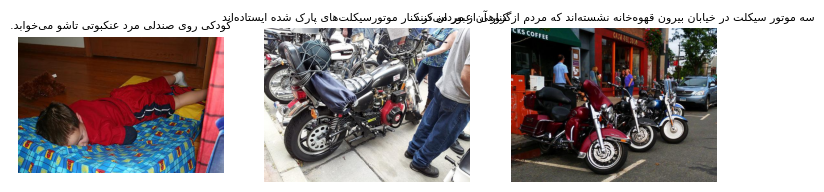

In [12]:
nsample = 3
samples = np.random.choice(list(train_captions.keys()),nsample)
plt.figure(figsize=(3*nsample,10))
reshaper = ArabicReshaper()

for i,image_file in enumerate(samples):
  caption = train_captions[image_file]
  img = Image.open(os.path.join(images_path,image_file))

  plt.subplot(1,nsample,i+1)
  plt.imshow(img)

  reshaped_text = reshaper.reshape(caption)
  caption = get_display(reshaped_text)

  plt.title(caption,fontsize=8)
  plt.axis('off')

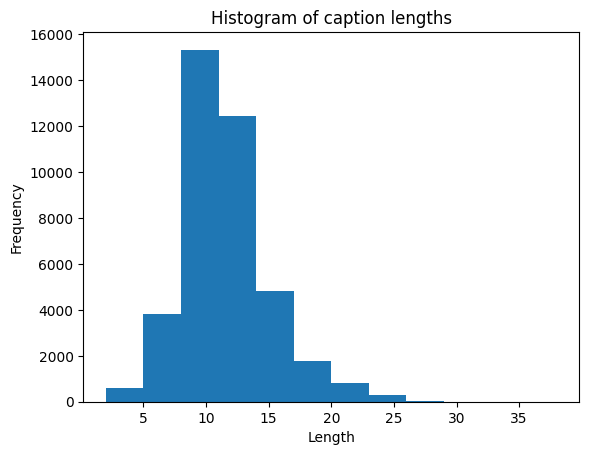

In [ ]:
caption_lengths = [len(word_tokenize(caption)) for caption in captions.values()]
plt.hist(caption_lengths, bins=12)
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.title('Histogram of caption lengths')
plt.show()

## <a id='toc2_4_'></a>[Create the dataset](#toc0_)

In [14]:
class COCODataset(Dataset):
  def __init__(self, image_dir, captions, tokenizer, transform = None):
    self.images_dir = image_dir
    self.transform = transform
    self.captions = captions
    self.ids = defaultdict(list)
    for img,caption in captions.items():
      self.ids[img] = tokenizer.text_to_ids(caption)
    self.tokenizer = tokenizer
    self.image_files = list(captions.keys())

  def __len__(self):
    return len(self.image_files)

  def get_transform(self):
    return self.transform

  def set_transform(self, transform):
    self.transform = transform

  def __getitem__(self, index):
    image_file = self.image_files[index]
    image_path = os.path.join(self.images_dir,image_file)
    image = Image.open(image_path).convert('RGB')
    if self.transform:
      image = self.transform(image)
    ids = self.ids[image_file]
    return index, image, ids

In [15]:
weights = models.EfficientNet_B4_Weights.IMAGENET1K_V1
transform = weights.transforms()

[   0 2948    3 2969 2710 2079 2969 2962    3 2970    1    2    2    2
    2    2    2    2    2    2    2    2    2    2    2    2    2    2
    2    2    2    2    2    2    2    2    2    2    2    2]
<sos> زنی <unk> در ایستگاه آشپزی در حال <unk> . <eos>


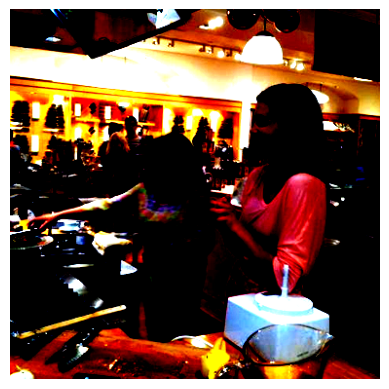

In [ ]:
train_dataset = COCODataset(images_path,train_captions,tokenizer,transform = transform)
val_dataset = COCODataset(images_path,val_captions,tokenizer,transform = transform)
test_dataset = COCODataset(images_path,test_captions,tokenizer,transform = transform)

_,image,captions = train_dataset[0]
print(captions)
print(tokenizer.ids_to_text(captions))
plt.imshow(image.permute(1,2,0).clip(0,1))
plt.axis('off')
plt.show()

# <a id='toc3_'></a>[Create the model](#toc0_)

In [ ]:
def print_number_of_params(model_summary):
    print(f"Total params:",model_summary.total_params)
    print(f"Trainable params:",model_summary.trainable_params)
    print(f"Non-trainable params:",model_summary.total_params-model_summary.trainable_params)

## <a id='toc3_1_'></a>[Encoder](#toc0_)

In [18]:
class Encoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = models.efficientnet_b4(weights=weights).features
        for param in self.model.parameters():
            param.requires_grad = False

    def forward(self, x):
        features = self.model(x)
        B, C, H, W = features.size()
        return features.view(B, C, -1).permute(0, 2, 1)

input_size = 380
model_summary = summary(Encoder(),(1,3,input_size,input_size))
output_tensor = Encoder()(torch.rand((1,3,input_size,input_size)))
print_number_of_params(model_summary)

Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-23ab8bcd.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-23ab8bcd.pth
100%|██████████| 74.5M/74.5M [00:00<00:00, 85.1MB/s]


Total params: 17548616
Trainable params: 0
Non-trainable params: 17548616


In [ ]:
features_shape = output_tensor.shape
print(features_shape)

torch.Size([1, 144, 1792])


## <a id='toc3_2_'></a>[Decoder](#toc0_)

In [20]:
class Attention(nn.Module):
    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        super().__init__()
        self.w_a = nn.Linear(encoder_dim, attention_dim)
        self.w_h = nn.Linear(decoder_dim, attention_dim)
        self.w_v = nn.Linear(attention_dim, 1)
        self.tanh = nn.Tanh()
        self.softmax = nn.Softmax(dim=1)
        self.beta_layer = nn.Linear(decoder_dim, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, a, h):
        att_a = self.w_a(a)
        att_h = self.w_h(h).unsqueeze(1)
        att = self.w_v(self.tanh(att_a + att_h)).squeeze(2)
        alpha = self.softmax(att)
        weighted_sum = (a * alpha.unsqueeze(2)).sum(dim=1)
        beta = self.sigmoid(self.beta_layer(h))
        context = beta * weighted_sum
        return context, alpha

In [21]:
class LSTM(nn.Module):
    def __init__(self, hidden_dim, embed_dim, attention_dim):
        super().__init__()
        self.hidden_dim = hidden_dim
        self.embed_dim = embed_dim
        self.attention_dim = attention_dim

        # Input gate
        self.W_i = nn.Linear(hidden_dim, hidden_dim)
        self.U_i = nn.Linear(embed_dim, hidden_dim)
        self.A_i = nn.Linear(attention_dim, hidden_dim)
        self.b_i = nn.Parameter(torch.zeros(hidden_dim))

        # Forget gate
        self.W_f = nn.Linear(hidden_dim, hidden_dim)
        self.U_f = nn.Linear(embed_dim, hidden_dim)
        self.A_f = nn.Linear(attention_dim, hidden_dim)
        self.b_f = nn.Parameter(torch.zeros(hidden_dim))

        # Output gate
        self.W_o = nn.Linear(hidden_dim, hidden_dim)
        self.U_o = nn.Linear(embed_dim, hidden_dim)
        self.A_o = nn.Linear(attention_dim, hidden_dim)
        self.b_o = nn.Parameter(torch.zeros(hidden_dim))

        # Input modulation gate
        self.W_g = nn.Linear(hidden_dim, hidden_dim)
        self.U_g = nn.Linear(embed_dim, hidden_dim)
        self.A_g = nn.Linear(attention_dim, hidden_dim)
        self.b_g = nn.Parameter(torch.zeros(hidden_dim))

    def forward(self, h_prev, c_prev, embedding_prev, context):
        i_t = torch.sigmoid(
            self.W_i(h_prev) + self.U_i(embedding_prev) + self.A_i(context) + self.b_i
        )
        f_t = torch.sigmoid(
            self.W_f(h_prev) + self.U_f(embedding_prev) + self.A_f(context) + self.b_f
        )
        o_t = torch.sigmoid(
            self.W_o(h_prev) + self.U_o(embedding_prev) + self.A_o(context) + self.b_o
        )
        g_t = torch.tanh(
            self.W_g(h_prev) + self.U_g(embedding_prev) + self.A_g(context) + self.b_g
        )

        c_t = f_t * c_prev + i_t * g_t
        h_t = o_t * torch.tanh(c_t)

        return h_t, c_t

In [ ]:
class Decoder(nn.Module):
    def __init__(self, vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim):
        super().__init__()
        self.encoder_dim = encoder_dim
        self.decoder_dim = decoder_dim
        self.vocab_size = vocab_size
        self.attention = Attention(encoder_dim, decoder_dim, attention_dim)

        self.embedding = nn.Embedding(vocab_size, embed_dim)
        self.dropout_e = nn.Dropout(0.5)
        self.lstm = LSTM(decoder_dim,embed_dim,encoder_dim)

        self.L_h = nn.Linear(decoder_dim, embed_dim)
        self.L_z = nn.Linear(encoder_dim, embed_dim)
        self.L_o = nn.Linear(embed_dim, vocab_size)
        self.dropout_o = nn.Dropout(0.5)

        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)

    def forward(self, features, captions):
        batch_size = features.size(0)
        num_pixels = features.size(1)
        vocab_size = self.vocab_size
        seq_len = captions.size(1)
        embeddings = self.dropout_e(self.embedding(captions))

        mean_a = features.mean(dim=1)
        h = self.init_h(mean_a)
        c = self.init_c(mean_a)

        predictions = torch.zeros(batch_size, seq_len, vocab_size).to(features.device)
        alphas = torch.zeros(batch_size, seq_len, num_pixels).to(features.device)

        for t in range(1,seq_len):
            z, alpha = self.attention(features, h)
            word_embed = embeddings[:, t-1]

            h, c = self.lstm(h, c, word_embed, z)

            out_h = self.L_h(h)
            out_z = self.L_z(z)
            out_o = word_embed+out_h+out_z
            out = self.L_o(self.dropout_o(out_o))

            predictions[:, t] = out
            alphas[:, t] = alpha

        return predictions, alphas

    def generate_greedy(self, features, max_new_tokens):
        batch_size = features.size(0)
        num_pixels = features.size(1)
        vocab_size = self.vocab_size
        seq_len = max_new_tokens

        mean_a = features.mean(dim=1)
        h = self.init_h(mean_a)
        c = self.init_c(mean_a)

        outputs = torch.zeros((batch_size, seq_len), dtype=torch.int).to(features.device)
        alphas = torch.zeros((batch_size, seq_len, num_pixels)).to(features.device)

        for t in range(1,seq_len):
            z, alpha = self.attention(features, h)
            word_embed = self.dropout_e(self.embedding(outputs[:,t-1]))

            h, c = self.lstm(h, c, word_embed, z)

            out_h = self.L_h(h)
            out_z = self.L_z(z)
            out_o = word_embed+out_h+out_z
            out = self.L_o(self.dropout_o(out_o))

            outputs[:, t] = out.argmax(dim=-1)
            alphas[:, t] = alpha
        return outputs, alphas

    def generate_beam_search(self, features, beam_width, max_new_tokens):
        B = features.size(0)
        K = beam_width
        V = self.vocab_size
        H = self.decoder_dim
        T = max_new_tokens
        features = features.unsqueeze(1).repeat(1, K, 1, 1).view(B * K, features.size(1), features.size(2))

        mean_a = features.mean(dim=1)
        h = self.init_h(mean_a)
        c = self.init_c(mean_a)

        outputs = torch.zeros((B * K, T), dtype=torch.int, device=features.device)
        alphas = torch.zeros((B * K, T, features.size(1))).to(features.device)

        z, alpha = self.attention(features, h)
        word_embed = self.dropout_e(self.embedding(outputs[:, 0]))
        h, c = self.lstm(h, c, word_embed, z)

        out_h = self.L_h(h)
        out_z = self.L_z(z)
        out_o = word_embed+out_h+out_z
        out = self.L_o(self.dropout_o(out_o))
        log_probs = torch.log_softmax(out, dim=-1)

        total_scores = log_probs.view(B, K, V)[:, 0, :]
        top_scores, token_indices = total_scores.topk(K, dim=-1)

        outputs[:, 1] = token_indices.view(-1)
        alphas[:, 1] = alpha
        beam_scores = top_scores.view(-1, 1)

        for t in range(2,T):
            z, alpha = self.attention(features, h)
            word_embed = self.dropout_e(self.embedding(outputs[:, t-1]))
            h, c = self.lstm(h, c, word_embed, z)

            out_h = self.L_h(h)
            out_z = self.L_z(z)
            out_o = word_embed+out_h+out_z
            out = self.L_o(self.dropout_o(out_o))
            log_probs = torch.log_softmax(out, dim=-1)

            total_scores = beam_scores.view(B, K, 1) + log_probs.view(B, K, V)
            total_scores = total_scores.view(B, -1)

            top_scores, top_indices = total_scores.topk(K, dim=-1)
            beam_indices = top_indices // V
            token_indices = top_indices % V

            flat_old_indices = (torch.arange(B, device=features.device).unsqueeze(1) * K + beam_indices).view(-1)
            outputs = outputs[flat_old_indices]
            outputs[:, t] = token_indices.view(-1)

            h = h[flat_old_indices]
            c = c[flat_old_indices]
            z = z[flat_old_indices]
            alpha = alpha[flat_old_indices]
            alphas[:, t] = alpha
            beam_scores = top_scores

        best_beam = beam_scores.argmax(dim=1)
        final_outputs = outputs.view(B, K, T)
        best_outputs = final_outputs[torch.arange(B), best_beam]
        final_alphas = alphas.view(B, K, T, -1)
        best_alphas = final_alphas[torch.arange(B), best_beam]
        return best_outputs, best_alphas

dummy_input = torch.randn(1,196,features_shape[-1]).to(device)
dummy_caption = torch.randint(0, 100, (1,42)).long().to(device)
model_summary = summary(Decoder(len(tokenizer.dictionary), 300, 512, features_shape[-1], 512).to(device), input_data=(dummy_input, dummy_caption))
print_number_of_params(model_summary)

Total params: 10836285
Trainable params: 10836285
Non-trainable params: 0


## <a id='toc3_3_'></a>[Model](#toc0_)

In [ ]:
class ImageCaptioningModel(nn.Module):
    def __init__(self, vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim):
        super().__init__()
        self.encoder = Encoder()
        self.decoder = Decoder(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

    def get_encoder(self):
        return self.encoder

    def get_decoder(self):
        return self.decoder

    def generate_greedy(self, images, max_new_tokens):
        features = self.encoder(images)
        return self.decoder.generate_greedy(features, max_new_tokens)

    def generate_beam_search(self, images, beam_width, max_new_tokens):
        features = self.encoder(images)
        return self.decoder.generate_beam_search(features, beam_width, max_new_tokens)

    def forward(self, images, captions):
        a = self.encoder(images)
        return self.decoder(a, captions)

dummy_image = torch.randn(1,3,input_size,input_size).to(device)
dummy_caption = torch.randint(0, 100, (1,42)).long().to(device)
model_summary = summary(ImageCaptioningModel(len(tokenizer.dictionary), 300, 512, features_shape[-1], 512).to(device), input_data=(dummy_image, dummy_caption))
print_number_of_params(model_summary)

Total params: 28384901
Trainable params: 10836285
Non-trainable params: 17548616


# <a id='toc4_'></a>[Train the model](#toc0_)

In [24]:
def train_step(model, tokenizer, data_loader, criterion, optimizer, lambda_regularization, device):
  model.train()
  total_loss = 0
  num_batches = len(data_loader)
  num_special_tokens = len(special_tokens.list_of_tokens)
  smooth = SmoothingFunction().method1
  all_references = []
  all_candidates = []

  for _, images, captions in data_loader:
    images = images.to(device)
    captions = captions.to(device)
    optimizer.zero_grad()
    predictions, alphas = model(images, captions)

    predicted_ids = predictions.argmax(dim=-1).detach().cpu().tolist()
    target_ids = captions.detach().cpu().tolist()

    for target, pred in zip(target_ids, predicted_ids):
      target = [token for token in target if token >= num_special_tokens]
      pred = [token for token in pred if token >= num_special_tokens]
      all_references.append([target])
      all_candidates.append(pred)

    captions = captions
    predictions = predictions.view(-1, predictions.size(-1))
    captions = captions.reshape(-1)

    crossentropy_loss  = criterion(predictions, captions)
    regularization_loss = ((1. - alphas.sum(dim=1)) ** 2).mean(dim=1).mean()
    loss = crossentropy_loss + lambda_regularization * regularization_loss

    loss.backward()
    optimizer.step()
    total_loss += loss.item()

  bleu = corpus_bleu(all_references, all_candidates, smoothing_function=smooth)
  return total_loss / num_batches, bleu

def validation_step(model, tokenizer, data_loader, criterion, lambda_regularization, device):
  model.eval()
  total_loss = 0
  num_batches = len(data_loader)
  num_special_tokens = len(special_tokens.list_of_tokens)
  smooth = SmoothingFunction().method1
  all_references = []
  all_candidates = []

  with torch.no_grad():
    for _, images, captions in data_loader:
      images = images.to(device)
      captions = captions.to(device)
      predictions, alphas = model(images, captions)

      predicted_ids = predictions.argmax(dim=-1).detach().cpu().tolist()
      target_ids = captions.detach().cpu().tolist()

      for target, pred in zip(target_ids, predicted_ids):
        target = [token for token in target if token >= num_special_tokens]
        pred = [token for token in pred if token >= num_special_tokens]
        all_references.append([target])
        all_candidates.append(pred)

      captions = captions
      predictions = predictions.view(-1, predictions.size(-1))
      captions = captions.reshape(-1)

      crossentropy_loss  = criterion(predictions, captions)
      regularization_loss = ((1. - alphas.sum(dim=1)) ** 2).mean(dim=1).mean()
      loss = crossentropy_loss + lambda_regularization * regularization_loss
      total_loss += loss.item()

  bleu = corpus_bleu(all_references, all_candidates, smoothing_function=smooth)
  return total_loss / num_batches, bleu

In [25]:
def train(model, train_loader, val_loader, val_dataset, tokenizer, criterion, optimizer, epochs, checkpoint_path, device, scheduler = None, do_early_stopping = False, lambda_regularization=0.5,early_stop_patience=10,warmup_epochs=3):
  hist = {
      "train_loss": [],
      "train_bleu": [],
      "val_loss": [],
      "val_bleu": [],
  }

  max_val_bleu = 0
  patience = early_stop_patience
  warmup_epochs = warmup_epochs
  transform = val_dataset.get_transform()
  model = model.to(device)
  reshaper = ArabicReshaper()

  for epoch in range(1, epochs + 1):
    train_loss, train_bleu = train_step(model, tokenizer, train_loader, criterion, optimizer, lambda_regularization, device)
    hist['train_loss'].append(train_loss)
    hist['train_bleu'].append(train_bleu)
    print(f"Epoch [{epoch}] Average Training Loss: {train_loss:.4f} Average Training BLEU: {train_bleu:.4f}")

    if scheduler != None:
      scheduler.step()

    val_loss, val_bleu = validation_step(model, tokenizer, val_loader, criterion, lambda_regularization, device)
    hist['val_loss'].append(val_loss)
    hist['val_bleu'].append(val_bleu)
    print(f"Epoch [{epoch}] Average Validation Loss: {val_loss:.4f} Average Validation BLEU: {val_bleu:.4f}")

    val_dataset.set_transform(None)
    _, image,_ = val_dataset[0]

    val_dataset.set_transform(transform)
    _, processed_image,_ = val_dataset[0]
    captions,_ = model.generate_greedy(processed_image.unsqueeze(0).to(device), tokenizer.context_length)
    caption = tokenizer.ids_to_text(captions[0], ignore_special_tokens=True)
    reshaped_text = reshaper.reshape(caption)
    caption = get_display(reshaped_text)

    plt.figure(figsize=(5,5))
    plt.imshow(image)
    plt.title(caption)
    plt.axis('off')
    plt.show()

    if do_early_stopping:
      if val_bleu - max_val_bleu < 1e-3:
        if epoch >= warmup_epochs:
          patience -= 1
      else:
        patience = min(patience+1,early_stop_patience)

      if val_bleu > max_val_bleu:
        max_val_bleu = val_bleu
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'history': hist,
            'patience': patience,
        }
        if scheduler != None:
          checkpoint['scheduler_state_dict'] = scheduler.state_dict()
        torch.save(checkpoint, checkpoint_path)

      if patience == 0:
        print(f"Early stopping epoch: {epoch}")
        checkpoint = torch.load(checkpoint_path)
        if scheduler != None:
          scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        epoch = checkpoint['epoch']
        break

  checkpoint = {
      'epoch': epoch-1,
      'model_state_dict': model.state_dict(),
      'optimizer_state_dict': optimizer.state_dict(),
      'history': hist,
      'patience': patience,
  }
  if scheduler != None:
      checkpoint['scheduler_state_dict'] = scheduler.state_dict()
  torch.save(checkpoint, checkpoint_path)
  return hist

In [26]:
batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

Epoch [1] Average Training Loss: 5.9898 Average Training BLEU: 0.0023
Epoch [1] Average Validation Loss: 4.6669 Average Validation BLEU: 0.0058


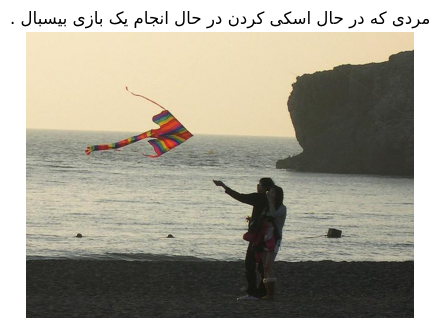

Epoch [2] Average Training Loss: 5.0224 Average Training BLEU: 0.0059
Epoch [2] Average Validation Loss: 4.2723 Average Validation BLEU: 0.0377


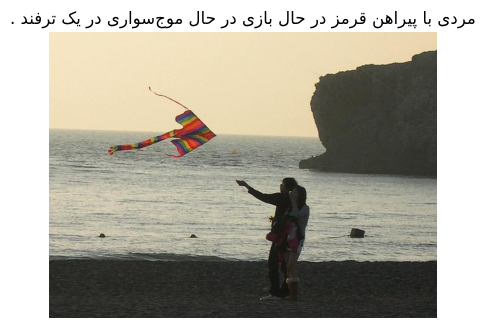

Epoch [3] Average Training Loss: 4.6093 Average Training BLEU: 0.0106
Epoch [3] Average Validation Loss: 4.1550 Average Validation BLEU: 0.0193


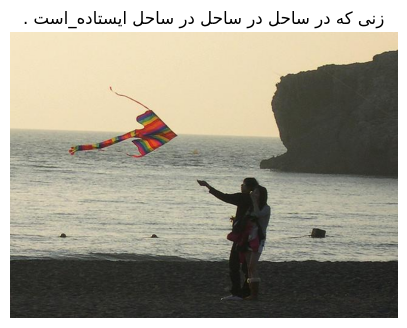

Epoch [4] Average Training Loss: 4.3523 Average Training BLEU: 0.0147
Epoch [4] Average Validation Loss: 4.0533 Average Validation BLEU: 0.0247


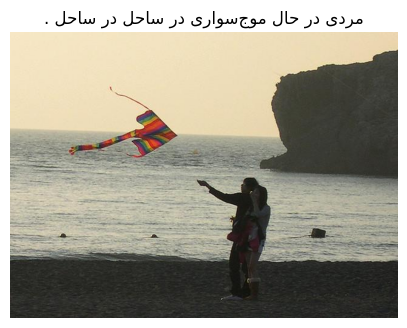

Epoch [5] Average Training Loss: 4.1694 Average Training BLEU: 0.0156
Epoch [5] Average Validation Loss: 3.9905 Average Validation BLEU: 0.0195


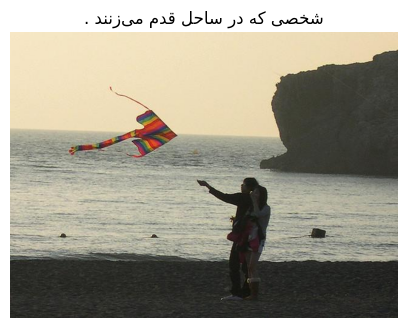

Epoch [6] Average Training Loss: 4.0236 Average Training BLEU: 0.0181
Epoch [6] Average Validation Loss: 3.9569 Average Validation BLEU: 0.0186


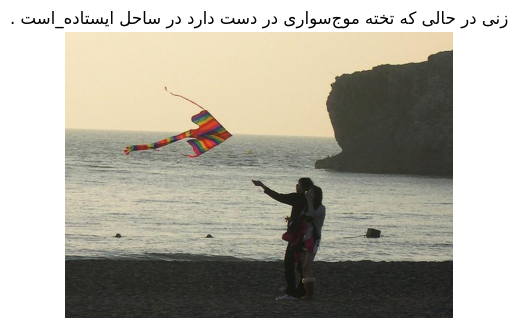

Epoch [7] Average Training Loss: 3.9051 Average Training BLEU: 0.0218
Epoch [7] Average Validation Loss: 3.9277 Average Validation BLEU: 0.0591


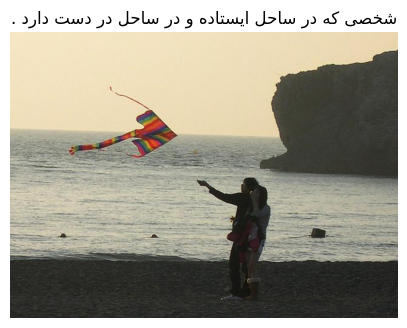

Epoch [8] Average Training Loss: 3.8102 Average Training BLEU: 0.0291
Epoch [8] Average Validation Loss: 3.9239 Average Validation BLEU: 0.0202


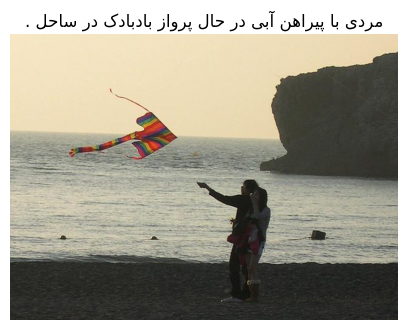

Epoch [9] Average Training Loss: 3.7416 Average Training BLEU: 0.0276
Epoch [9] Average Validation Loss: 3.9196 Average Validation BLEU: 0.0528


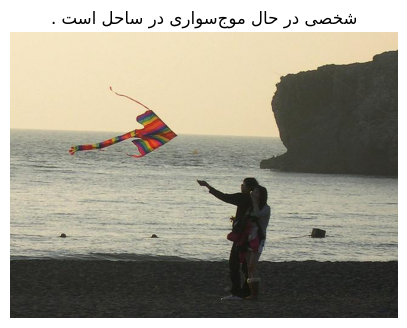

Epoch [10] Average Training Loss: 3.6643 Average Training BLEU: 0.0320
Epoch [10] Average Validation Loss: 3.9320 Average Validation BLEU: 0.0285


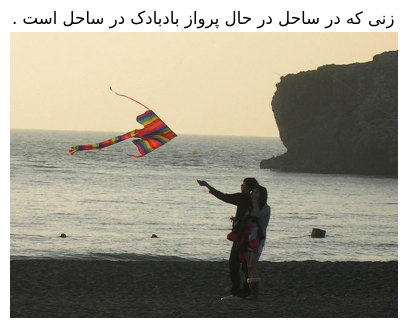

Epoch [11] Average Training Loss: 3.5991 Average Training BLEU: 0.0371
Epoch [11] Average Validation Loss: 3.9186 Average Validation BLEU: 0.0775


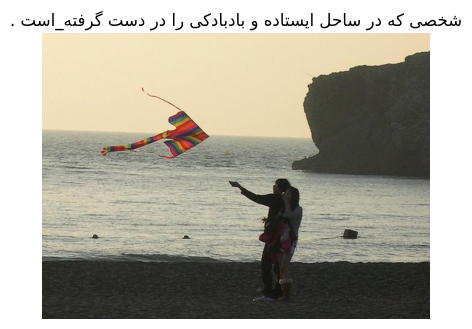

Epoch [12] Average Training Loss: 3.5389 Average Training BLEU: 0.0391
Epoch [12] Average Validation Loss: 3.9368 Average Validation BLEU: 0.0236


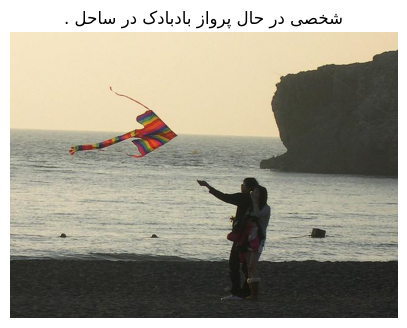

Epoch [13] Average Training Loss: 3.4825 Average Training BLEU: 0.0420
Epoch [13] Average Validation Loss: 3.9455 Average Validation BLEU: 0.0816


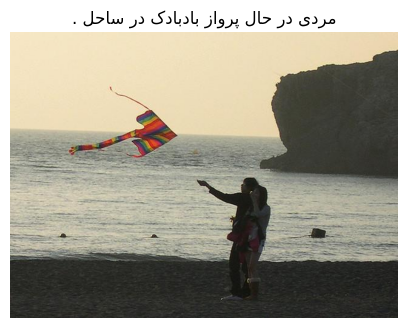

Epoch [14] Average Training Loss: 3.4528 Average Training BLEU: 0.0412
Epoch [14] Average Validation Loss: 3.9327 Average Validation BLEU: 0.0911


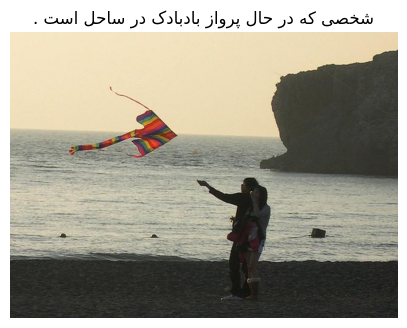

Epoch [15] Average Training Loss: 3.3751 Average Training BLEU: 0.0394
Epoch [15] Average Validation Loss: 3.9826 Average Validation BLEU: 0.0681


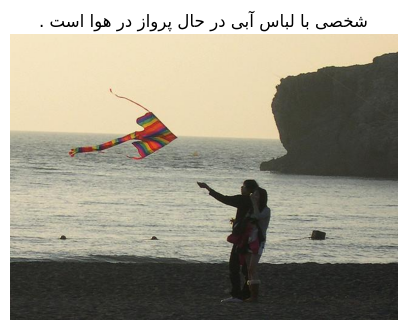

Epoch [16] Average Training Loss: 3.3265 Average Training BLEU: 0.0397
Epoch [16] Average Validation Loss: 3.9771 Average Validation BLEU: 0.0854


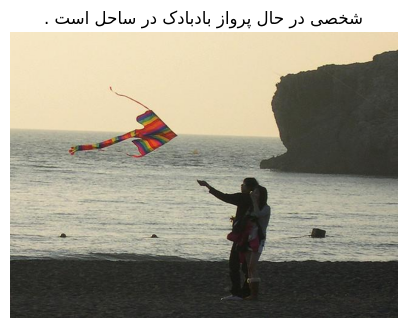

Epoch [17] Average Training Loss: 3.3110 Average Training BLEU: 0.0388
Epoch [17] Average Validation Loss: 4.0138 Average Validation BLEU: 0.0710


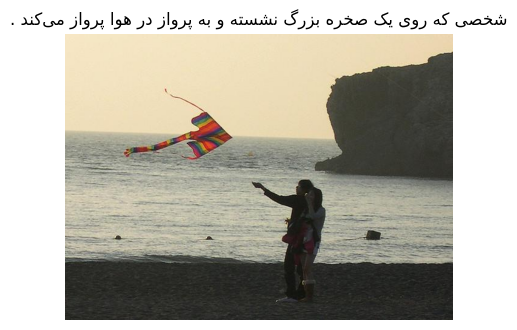

Epoch [18] Average Training Loss: 3.2240 Average Training BLEU: 0.0464
Epoch [18] Average Validation Loss: 4.0343 Average Validation BLEU: 0.0258


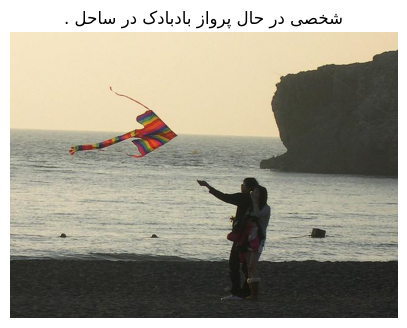

Epoch [19] Average Training Loss: 3.2131 Average Training BLEU: 0.0418
Epoch [19] Average Validation Loss: 4.0185 Average Validation BLEU: 0.0253


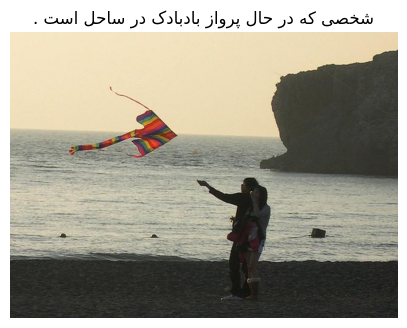

Epoch [20] Average Training Loss: 3.1530 Average Training BLEU: 0.0558
Epoch [20] Average Validation Loss: 4.0714 Average Validation BLEU: 0.0219


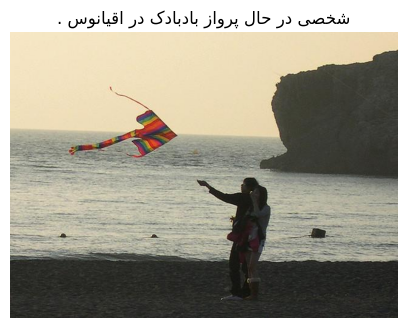

Early stopping epoch: 20


In [ ]:
epochs = 50
lr = 1e-2
weight_decay = 1e-5

vocab_size = len(tokenizer.dictionary)
embed_dim = 300
decoder_dim = 512
encoder_dim = features_shape[-1]
attention_dim = 512
model = ImageCaptioningModel(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.98)
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.dictionary[special_tokens.Pad])

hist = train(model, train_loader, val_loader, val_dataset, tokenizer, criterion, optimizer, epochs, 'checkpoint_loss.pth', device, scheduler, True, 1)

In [ ]:
model.eval()
# ! cp 'checkpoint_loss.pth' '/content/drive/MyDrive/Colab/NNDL/CAe/Part2/Models/'
print()

In [ ]:
def plot_history(history):
    epochs = len(history['train_loss'])
    plt.plot(range(1,epochs+1), history['train_loss'])
    plt.plot(range(1,epochs+1), history['val_loss'])
    plt.title('Loss of model')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train Loss', 'Validation Loss'])
    plt.ylim(min(min(history['train_loss']),min(history['val_loss']))*0.95,
             max(max(history['train_loss']),max(history['val_loss']))*1.05)
    plt.show()

    epochs = len(history['train_bleu'])
    plt.plot(range(1,epochs+1), history['train_bleu'])
    plt.plot(range(1,epochs+1), history['val_bleu'])
    plt.title('BLEU score of model')
    plt.ylabel('BLEU')
    plt.xlabel('Epoch')
    plt.legend(['Train BLEU', 'Validation BLEU'])
    plt.ylim(0, max(max(history['train_bleu']),max(history['val_bleu']))*1.05)
    plt.show()

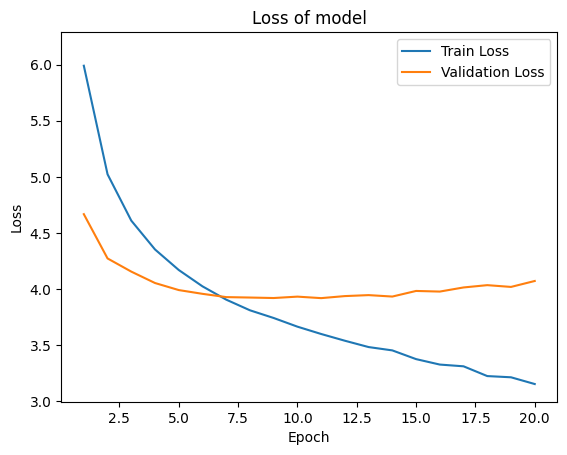

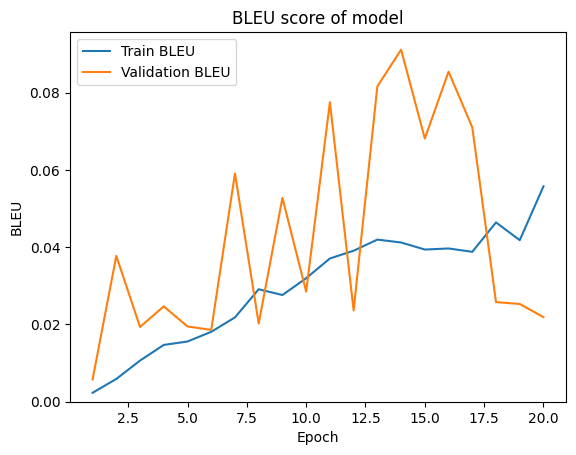

In [ ]:
plot_history(hist)

In [27]:
def plot_generations(model, tokenizer, beam_width, nsample, dataset, max_new_tokens):
    transform = dataset.get_transform()
    dataset.set_transform(None)

    rows = nsample
    cols = 2
    fig, axes = plt.subplots(rows, cols, figsize=(12, 3.5 * rows))
    axes = axes.reshape(rows, cols)

    reshaper = ArabicReshaper()
    end_id = tokenizer.dictionary[special_tokens.End]
    start_id = tokenizer.dictionary[special_tokens.Start]

    for i in range(nsample):
        _, image, caption = dataset[i]
        transformed_image = transform(image)

        lines = []
        ref_text = tokenizer.ids_to_text(caption, ignore_special_tokens=True)
        lines.append(f"True: {ref_text}")

        greedy = model.generate_greedy(transformed_image.unsqueeze(0).to(device), max_new_tokens)
        greedy_text = tokenizer.ids_to_text(greedy[0][0], ignore_special_tokens=True)
        lines.append(f"Greedy: {greedy_text}")

        beam = model.generate_beam_search(transformed_image.unsqueeze(0).to(device), beam_width, max_new_tokens)
        beam_text = tokenizer.ids_to_text(beam[0][0], ignore_special_tokens=True)
        lines.append(f"Beam (K={beam_width}): {beam_text}")

        axes[i, 0].imshow(image)
        axes[i, 0].axis('off')

        axes[i, 1].axis('off')
        full_text = "\n\n".join(lines)
        reshaped_text = reshaper.reshape(full_text)
        caption_text = get_display(reshaped_text)
        axes[i, 1].text(0, 1, caption_text, fontsize=20, va='top', ha='left', wrap=True)

    plt.tight_layout()
    dataset.set_transform(transform)
    plt.show()

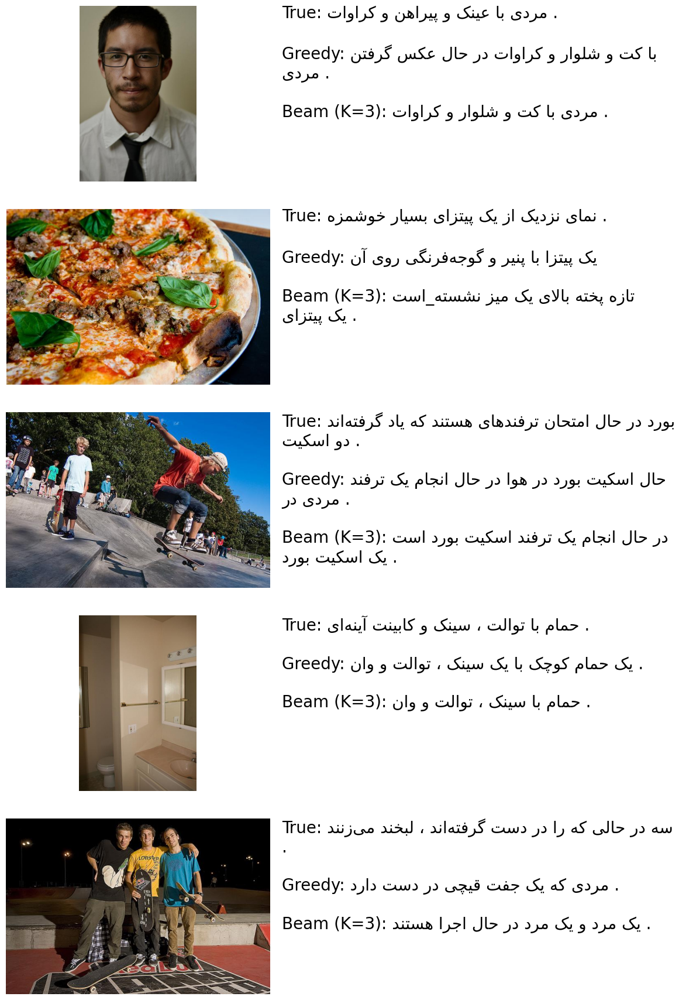

In [ ]:
beam_width = 3
nsample = 5
max_new_tokens = tokenizer.context_length
plot_generations(model, tokenizer, beam_width, nsample, test_dataset, max_new_tokens)

In [31]:
def evaluate(model, tokenizer, data_loader, beam_width, max_new_tokens):
    scores = defaultdict(lambda: defaultdict(float))
    all_references = []
    all_greedy = []
    all_beam = []
    num_special_tokens = len(special_tokens.list_of_tokens)
    smooth = SmoothingFunction().method1

    for _, images, captions in data_loader:
      images = images.to(device)
      greedy_ids,_ = model.generate_greedy(images,max_new_tokens)
      greedy_ids = greedy_ids.cpu().tolist()
      beam_ids,_ = model.generate_beam_search(images,beam_width,max_new_tokens)
      beam_ids = beam_ids.cpu().tolist()
      target_ids = captions.tolist()

      for i in range(len(target_ids)):
        target = [token for token in target_ids[i] if token >= num_special_tokens]
        greedy = [token for token in greedy_ids[i] if token >= num_special_tokens]
        beam = [token for token in beam_ids[i] if token >= num_special_tokens]
        all_references.append([target])
        all_greedy.append(greedy)
        all_beam.append(beam)

    scores['Greedy']['BLEU-1'] = corpus_bleu(all_references, all_greedy, weights=(1, 0, 0, 0), smoothing_function=smooth)
    scores['Greedy']['BLEU-2'] = corpus_bleu(all_references, all_greedy, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)
    scores['Greedy']['BLEU-3'] = corpus_bleu(all_references, all_greedy, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth)
    scores['Greedy']['BLEU-4'] = corpus_bleu(all_references, all_greedy, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)

    scores["Beam "+f"K = {beam_width}"]['BLEU-1'] = corpus_bleu(all_references, all_beam, weights=(1, 0, 0, 0), smoothing_function=smooth)
    scores["Beam "+f"K = {beam_width}"]['BLEU-2'] = corpus_bleu(all_references, all_beam, weights=(0.5, 0.5, 0, 0), smoothing_function=smooth)
    scores["Beam "+f"K = {beam_width}"]['BLEU-3'] = corpus_bleu(all_references, all_beam, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smooth)
    scores["Beam "+f"K = {beam_width}"]['BLEU-4'] = corpus_bleu(all_references, all_beam, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smooth)

    return pd.DataFrame(scores).T

In [ ]:
evaluate(model, tokenizer, test_loader, beam_width, max_new_tokens)

,BLEU-1,BLEU-2,BLEU-3,BLEU-4
Greedy,0.315400,0.161123,0.090481,0.050306
Beam K = 3,0.300971,0.154804,0.092486,0.053113


In [27]:
def show_attn_maps(idx, test_dataset, model, tokenizer, max_new_tokens, alpha_size, cmap='jet', generate_greedy = True, beam_width = 3):
    reshaper = ArabicReshaper()
    transform = test_dataset.get_transform()
    num_special_tokens = len(special_tokens.list_of_tokens)
    end_id = tokenizer.dictionary[special_tokens.End]
    start_id = tokenizer.dictionary[special_tokens.Start]
    model.eval()

    test_dataset.set_transform(None)
    _, image, caption = test_dataset[idx]
    test_dataset.set_transform(transform)
    _, processed_image, caption = test_dataset[idx]
    processed_image = processed_image.unsqueeze(0).to(device)

    with torch.no_grad():
        if generate_greedy:
          predicted_ids, attn_maps = model.generate_greedy(processed_image, max_new_tokens)
        else:
          predicted_ids, attn_maps = model.generate_beam_search(processed_image, beam_width, max_new_tokens)
        predicted_ids = predicted_ids[0]
        text = tokenizer.ids_to_text(predicted_ids, ignore_special_tokens=False)
        tokens = tokenizer.tokenize(text)
        attn_maps = attn_maps[0]

        num_tokens = len(tokens)-1
        total_images = num_tokens + 1

        cols = 5
        rows = (total_images + cols - 1) // cols
        fig, axes = plt.subplots(rows, cols, figsize=(2 * cols, 2 * rows))
        axes = axes if isinstance(axes, np.ndarray) else np.array([[axes]])
        axes = axes.reshape(rows, cols)

        axes[0, cols - 1].imshow(image)
        axes[0, cols - 1].set_title("Original", fontsize=10)
        axes[0, cols - 1].axis('off')

        img_idx = 1
        for row in range(rows):
            for col in reversed(range(cols)):
                if row == 0 and col == cols-1:
                  continue
                if img_idx > num_tokens:
                    axes[row, col].axis('off')
                    continue

                word = tokens[img_idx]
                alpha = attn_maps[img_idx].view(alpha_size, alpha_size).unsqueeze(0).unsqueeze(0)
                alpha_resized = F.interpolate(alpha, size=image.size[::-1], mode='bilinear', align_corners=False)
                alpha_resized = alpha_resized.squeeze().cpu().numpy()

                word = reshaper.reshape(word)
                word = get_display(word)

                axes[row, col].imshow(image)
                axes[row, col].imshow(alpha_resized, alpha=0.5, cmap=cmap)
                axes[row, col].set_title(word, fontsize=10)
                axes[row, col].axis('off')
                img_idx += 1

        plt.tight_layout()
        plt.show()

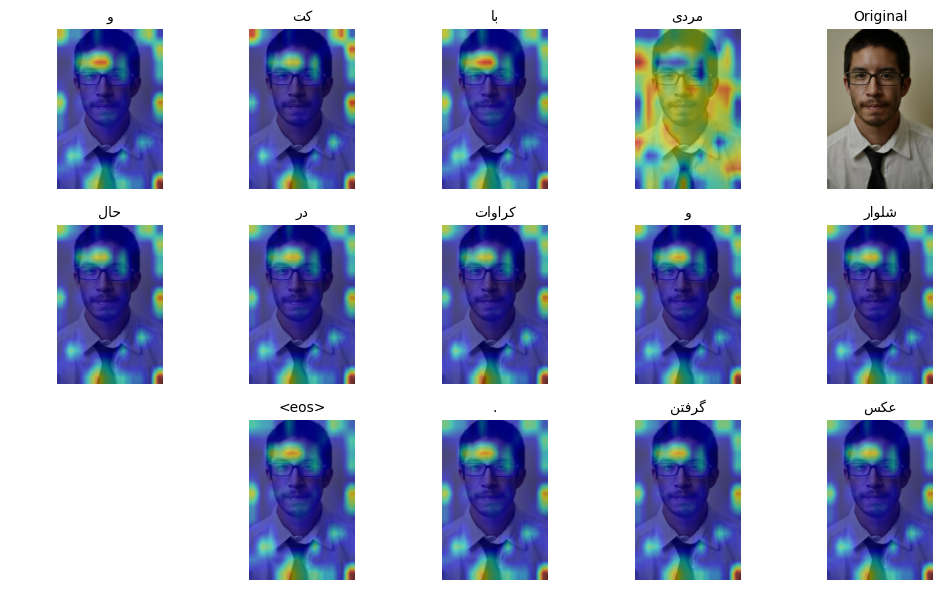

In [ ]:
alpha_size = int(np.sqrt(features_shape[1]))
show_attn_maps(0,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

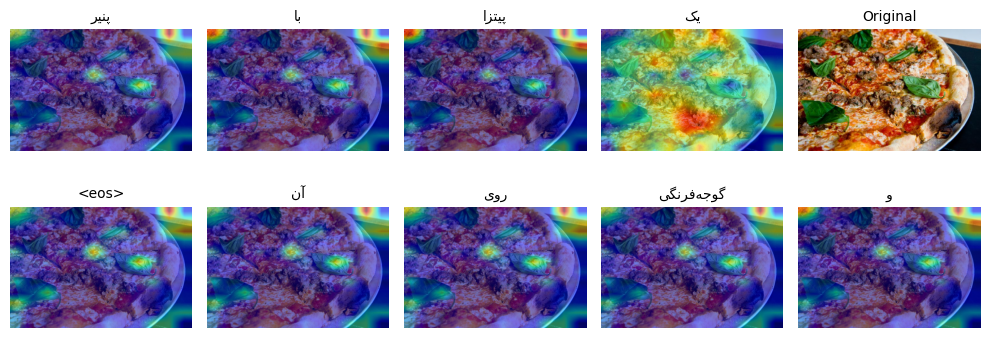

In [ ]:
show_attn_maps(1,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

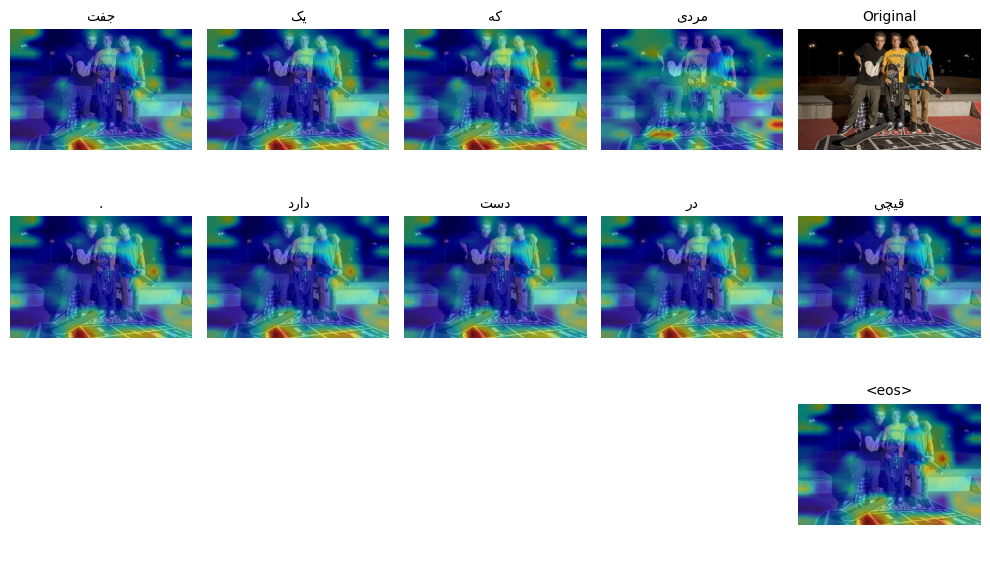

In [ ]:
show_attn_maps(4,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

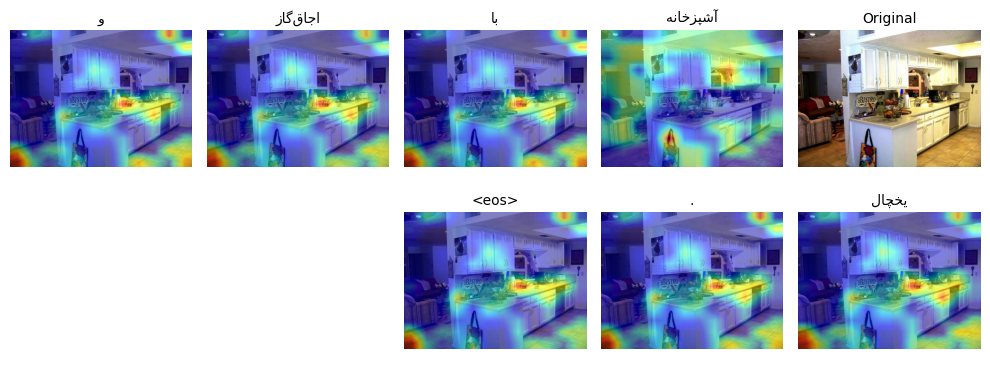

In [ ]:
show_attn_maps(8,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

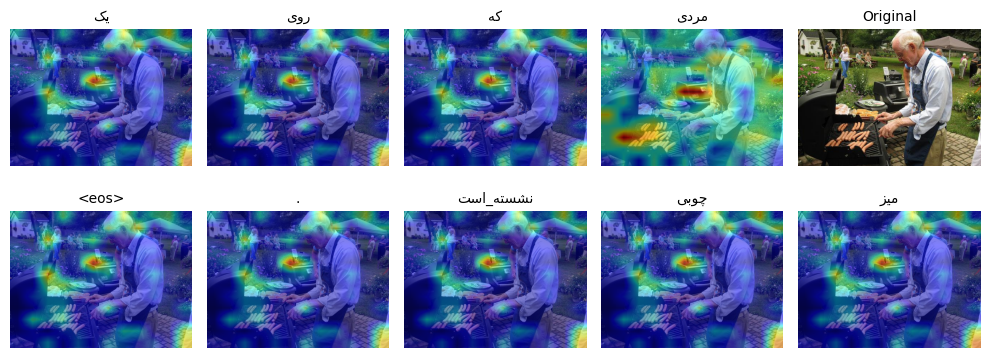

In [ ]:
show_attn_maps(22,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

# <a id='toc5_'></a>[Scheduled Sampling](#toc0_)

In [ ]:
class DecoderScheduledSampling(Decoder):
    def __init__(self, vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim):
        super().__init__(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

    def forward(self, features, captions, prob_teacher_forcing):
        batch_size = features.size(0)
        num_pixels = features.size(1)
        vocab_size = self.vocab_size
        seq_len = captions.size(1)

        mean_a = features.mean(dim=1)
        h = self.init_h(mean_a)
        c = self.init_c(mean_a)

        predictions = torch.zeros(batch_size, seq_len, vocab_size).to(features.device)
        alphas = torch.zeros(batch_size, seq_len, num_pixels).to(features.device)
        inputs = captions[:, 0]

        for t in range(1,seq_len):
            z, alpha = self.attention(features, h)
            teacher_forcing_mask = (torch.rand(batch_size) < prob_teacher_forcing).to(device)

            use_ground_truth = self.embedding(captions[:, t - 1])
            use_model_pred = self.embedding(inputs)

            word_embed = torch.where(
                teacher_forcing_mask.unsqueeze(1),
                use_ground_truth,
                use_model_pred
            )

            h, c = self.lstm(h, c, word_embed, z)

            out_h = self.L_h(h)
            out_z = self.L_z(z)
            out_o = word_embed+out_h+out_z
            out = self.L_o(self.dropout_o(out_o))

            predictions[:, t] = out
            inputs = out.argmax(dim=-1)
            alphas[:, t] = alpha

        return predictions, alphas

In [ ]:
class ImageCaptioningModelSceduledSampling(ImageCaptioningModel):
    def __init__(self, vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim):
        super().__init__(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)
        self.encoder = Encoder()
        self.decoder = DecoderScheduledSampling(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

    def forward(self, images, captions, prob_teacher_forcing):
        a = self.encoder(images)
        return self.decoder(a, captions, prob_teacher_forcing)

In [ ]:
def train_step_ss(model, tokenizer, data_loader, criterion, optimizer, lambda_regularization, prob, device):
  model.train()
  total_loss = 0
  num_batches = len(data_loader)
  num_special_tokens = len(special_tokens.list_of_tokens)
  smooth = SmoothingFunction().method1
  all_references = []
  all_candidates = []

  for _, images, captions in data_loader:
    images = images.to(device)
    captions = captions.to(device)
    optimizer.zero_grad()
    predictions, alphas = model(images, captions, prob)

    predicted_ids = predictions.argmax(dim=-1).detach().cpu().tolist()
    target_ids = captions.detach().cpu().tolist()

    for target, pred in zip(target_ids, predicted_ids):
      target = [token for token in target if token >= num_special_tokens]
      pred = [token for token in pred if token >= num_special_tokens]
      all_references.append([target])
      all_candidates.append(pred)

    captions = captions
    predictions = predictions.view(-1, predictions.size(-1))
    captions = captions.reshape(-1)

    crossentropy_loss  = criterion(predictions, captions)
    regularization_loss = ((1. - alphas.sum(dim=1)) ** 2).mean(dim=1).mean()
    loss = crossentropy_loss + lambda_regularization * regularization_loss

    loss.backward()
    optimizer.step()
    total_loss += loss.item()

  bleu = corpus_bleu(all_references, all_candidates, smoothing_function=smooth)
  return total_loss / num_batches, bleu

def validation_step_ss(model, tokenizer, data_loader, criterion, lambda_regularization, prob, device):
  model.eval()
  total_loss = 0
  num_batches = len(data_loader)
  num_special_tokens = len(special_tokens.list_of_tokens)
  smooth = SmoothingFunction().method1
  all_references = []
  all_candidates = []

  with torch.no_grad():
    for _, images, captions in data_loader:
      images = images.to(device)
      captions = captions.to(device)
      predictions, alphas = model(images, captions, prob)

      predicted_ids = predictions.argmax(dim=-1).detach().cpu().tolist()
      target_ids = captions.detach().cpu().tolist()

      for target, pred in zip(target_ids, predicted_ids):
        target = [token for token in target if token >= num_special_tokens]
        pred = [token for token in pred if token >= num_special_tokens]
        all_references.append([target])
        all_candidates.append(pred)

      captions = captions
      predictions = predictions.view(-1, predictions.size(-1))
      captions = captions.reshape(-1)

      crossentropy_loss  = criterion(predictions, captions)
      regularization_loss = ((1. - alphas.sum(dim=1)) ** 2).mean(dim=1).mean()
      loss = crossentropy_loss + lambda_regularization * regularization_loss
      total_loss += loss.item()

  bleu = corpus_bleu(all_references, all_candidates, smoothing_function=smooth)
  return total_loss / num_batches, bleu

In [ ]:
def train_ss(model, train_loader, val_loader, val_dataset, tokenizer, criterion, optimizer, epochs, checkpoint_path, device, scheduler = None, do_early_stopping = False, lambda_regularization=0.5,early_stop_patience=10,warmup_epochs=3):
  hist = {
      "train_loss": [],
      "train_bleu": [],
      "val_loss": [],
      "val_bleu": [],
  }

  max_val_bleu = 0
  patience = early_stop_patience
  warmup_epochs = warmup_epochs
  transform = val_dataset.get_transform()
  model = model.to(device)
  prob = 1
  reshaper = ArabicReshaper()

  for epoch in range(1, epochs + 1):
    train_loss, train_bleu = train_step_ss(model, tokenizer, train_loader, criterion, optimizer, lambda_regularization, prob, device)
    hist['train_loss'].append(train_loss)
    hist['train_bleu'].append(train_bleu)
    print(f"Epoch [{epoch}] Average Training Loss: {train_loss:.4f} Average Training BLEU: {train_bleu:.4f} Teacher Forcing Probability: {prob}")

    if scheduler != None:
      scheduler.step()

    val_loss, val_bleu = validation_step_ss(model, tokenizer, val_loader, criterion, lambda_regularization, prob, device)
    hist['val_loss'].append(val_loss)
    hist['val_bleu'].append(val_bleu)
    print(f"Epoch [{epoch}] Average Validation Loss: {val_loss:.4f} Average Validation BLEU: {val_bleu:.4f} Teacher Forcing Probability: {prob}")

    prob -= 0.02
    val_dataset.set_transform(None)
    _, image,_ = val_dataset[0]

    val_dataset.set_transform(transform)
    _, processed_image,_ = val_dataset[0]
    captions,_ = model.generate_greedy(processed_image.unsqueeze(0).to(device), tokenizer.context_length)
    caption = tokenizer.ids_to_text(captions[0], ignore_special_tokens=True)
    reshaped_text = reshaper.reshape(caption)
    caption = get_display(reshaped_text)

    plt.figure(figsize=(5,5))
    plt.imshow(image)
    plt.title(caption)
    plt.axis('off')
    plt.show()

    if do_early_stopping:
      if val_bleu - max_val_bleu < 1e-3:
        if epoch >= warmup_epochs:
          patience -= 1
      else:
        patience = min(patience+1,early_stop_patience)

      if val_bleu > max_val_bleu:
        max_val_bleu = val_bleu
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'history': hist,
            'patience': patience,
        }
        if scheduler != None:
          checkpoint['scheduler_state_dict'] = scheduler.state_dict()
        torch.save(checkpoint, checkpoint_path)

      if patience == 0:
        print(f"Early stopping epoch: {epoch}")
        checkpoint = torch.load(checkpoint_path)
        if scheduler != None:
          scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        epoch = checkpoint['epoch']
        break

  checkpoint = {
      'epoch': epoch-1,
      'model_state_dict': model.state_dict(),
      'optimizer_state_dict': optimizer.state_dict(),
      'history': hist,
      'patience': patience,
  }
  if scheduler != None:
      checkpoint['scheduler_state_dict'] = scheduler.state_dict()
  torch.save(checkpoint, checkpoint_path)
  return hist

Epoch [1] Average Training Loss: 5.5186 Average Training BLEU: 0.0040 Teacher Forcing Probability: 1
Epoch [1] Average Validation Loss: 4.4771 Average Validation BLEU: 0.0108 Teacher Forcing Probability: 1


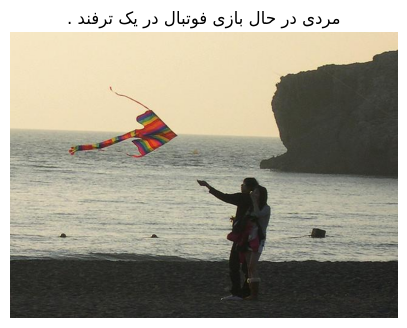

Epoch [2] Average Training Loss: 4.6291 Average Training BLEU: 0.0094 Teacher Forcing Probability: 0.98
Epoch [2] Average Validation Loss: 4.2949 Average Validation BLEU: 0.0138 Teacher Forcing Probability: 0.98


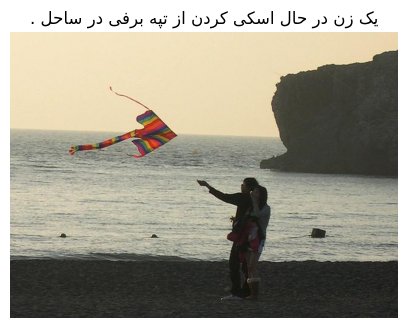

Epoch [3] Average Training Loss: 4.3643 Average Training BLEU: 0.0117 Teacher Forcing Probability: 0.96
Epoch [3] Average Validation Loss: 4.2420 Average Validation BLEU: 0.0154 Teacher Forcing Probability: 0.96


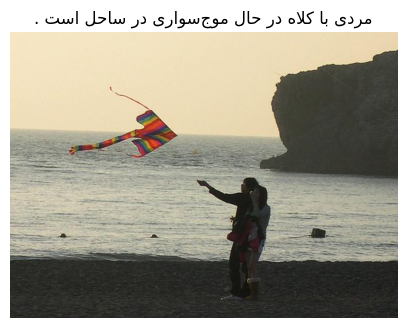

Epoch [4] Average Training Loss: 4.2166 Average Training BLEU: 0.0145 Teacher Forcing Probability: 0.94
Epoch [4] Average Validation Loss: 4.2144 Average Validation BLEU: 0.0159 Teacher Forcing Probability: 0.94


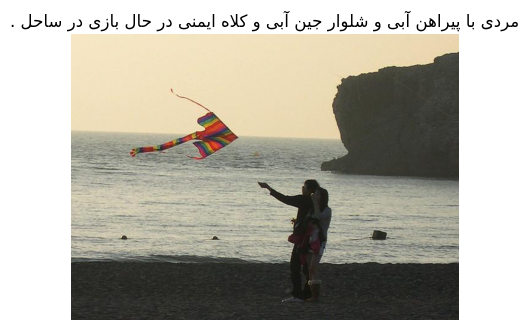

Epoch [5] Average Training Loss: 4.1416 Average Training BLEU: 0.0162 Teacher Forcing Probability: 0.9199999999999999
Epoch [5] Average Validation Loss: 4.1980 Average Validation BLEU: 0.0165 Teacher Forcing Probability: 0.9199999999999999


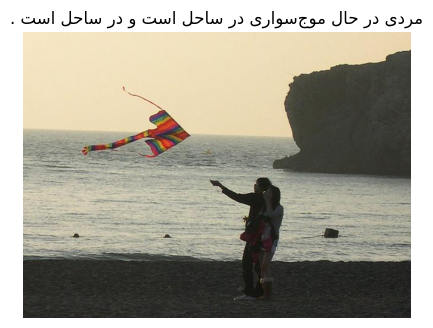

Epoch [6] Average Training Loss: 4.0627 Average Training BLEU: 0.0181 Teacher Forcing Probability: 0.8999999999999999
Epoch [6] Average Validation Loss: 4.2457 Average Validation BLEU: 0.0185 Teacher Forcing Probability: 0.8999999999999999


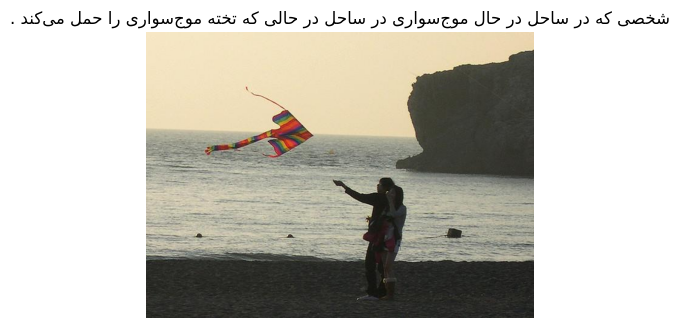

Epoch [7] Average Training Loss: 4.0874 Average Training BLEU: 0.0189 Teacher Forcing Probability: 0.8799999999999999
Epoch [7] Average Validation Loss: 4.3237 Average Validation BLEU: 0.0196 Teacher Forcing Probability: 0.8799999999999999


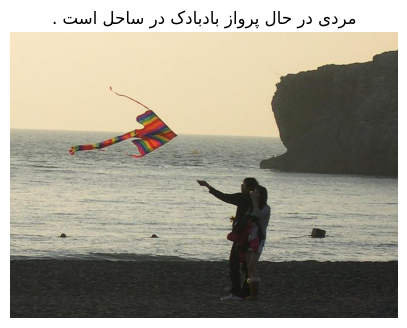

Epoch [8] Average Training Loss: 4.0836 Average Training BLEU: 0.0190 Teacher Forcing Probability: 0.8599999999999999
Epoch [8] Average Validation Loss: 4.3413 Average Validation BLEU: 0.0127 Teacher Forcing Probability: 0.8599999999999999


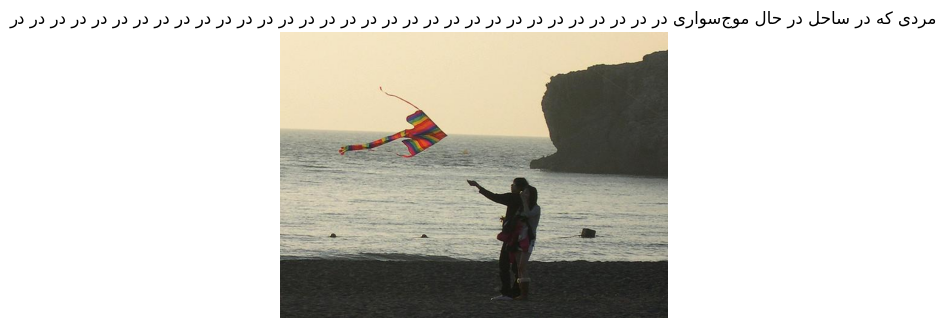

Epoch [9] Average Training Loss: 4.0294 Average Training BLEU: 0.0207 Teacher Forcing Probability: 0.8399999999999999
Epoch [9] Average Validation Loss: 4.3296 Average Validation BLEU: 0.0171 Teacher Forcing Probability: 0.8399999999999999


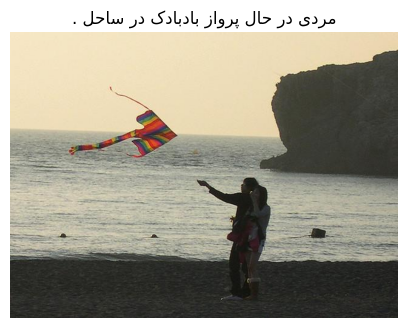

Epoch [10] Average Training Loss: 4.0123 Average Training BLEU: 0.0218 Teacher Forcing Probability: 0.8199999999999998
Epoch [10] Average Validation Loss: 4.3246 Average Validation BLEU: 0.0175 Teacher Forcing Probability: 0.8199999999999998


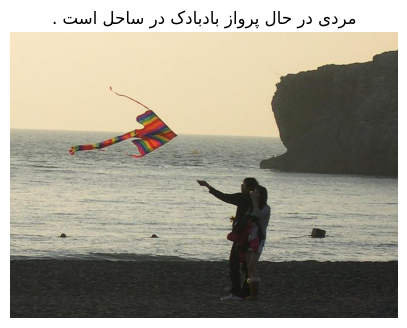

Epoch [11] Average Training Loss: 3.9821 Average Training BLEU: 0.0224 Teacher Forcing Probability: 0.7999999999999998
Epoch [11] Average Validation Loss: 4.3768 Average Validation BLEU: 0.0218 Teacher Forcing Probability: 0.7999999999999998


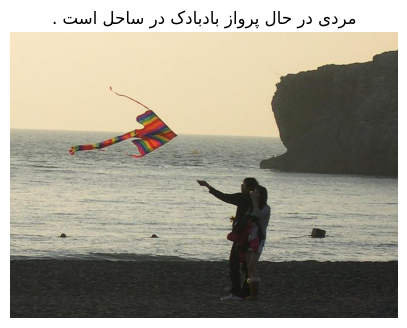

Epoch [12] Average Training Loss: 3.9631 Average Training BLEU: 0.0246 Teacher Forcing Probability: 0.7799999999999998
Epoch [12] Average Validation Loss: 4.3751 Average Validation BLEU: 0.0356 Teacher Forcing Probability: 0.7799999999999998


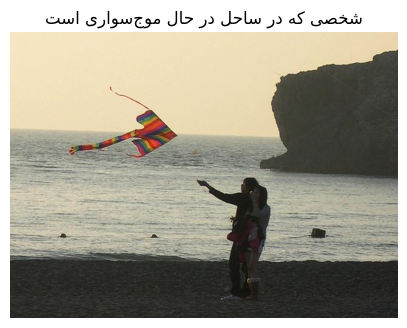

Epoch [13] Average Training Loss: 3.9654 Average Training BLEU: 0.0246 Teacher Forcing Probability: 0.7599999999999998
Epoch [13] Average Validation Loss: 4.4456 Average Validation BLEU: 0.0195 Teacher Forcing Probability: 0.7599999999999998


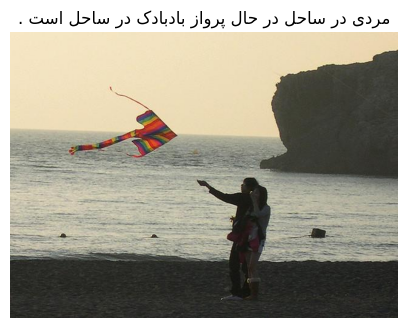

Epoch [14] Average Training Loss: 3.9630 Average Training BLEU: 0.0252 Teacher Forcing Probability: 0.7399999999999998
Epoch [14] Average Validation Loss: 4.4631 Average Validation BLEU: 0.0197 Teacher Forcing Probability: 0.7399999999999998


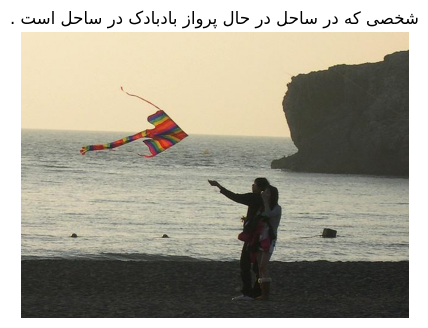

Epoch [15] Average Training Loss: 3.9714 Average Training BLEU: 0.0257 Teacher Forcing Probability: 0.7199999999999998
Epoch [15] Average Validation Loss: 4.4660 Average Validation BLEU: 0.0183 Teacher Forcing Probability: 0.7199999999999998


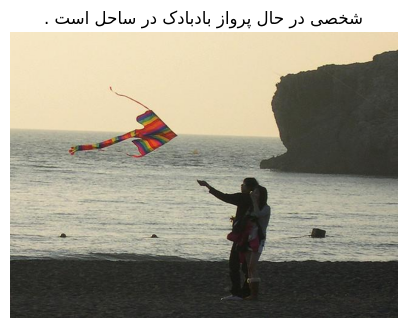

Epoch [16] Average Training Loss: 3.9753 Average Training BLEU: 0.0255 Teacher Forcing Probability: 0.6999999999999997
Epoch [16] Average Validation Loss: 4.5084 Average Validation BLEU: 0.0169 Teacher Forcing Probability: 0.6999999999999997


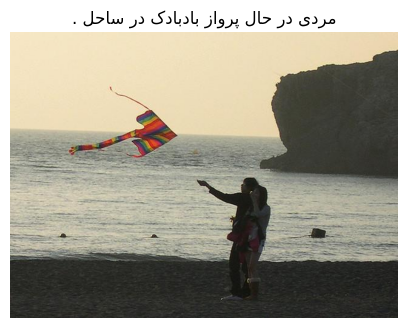

Epoch [17] Average Training Loss: 4.0001 Average Training BLEU: 0.0253 Teacher Forcing Probability: 0.6799999999999997
Epoch [17] Average Validation Loss: 4.5836 Average Validation BLEU: 0.0174 Teacher Forcing Probability: 0.6799999999999997


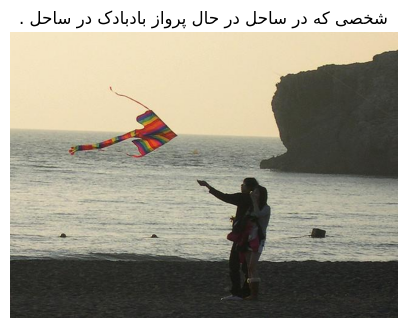

Epoch [18] Average Training Loss: 4.0091 Average Training BLEU: 0.0263 Teacher Forcing Probability: 0.6599999999999997
Epoch [18] Average Validation Loss: 4.5416 Average Validation BLEU: 0.0164 Teacher Forcing Probability: 0.6599999999999997


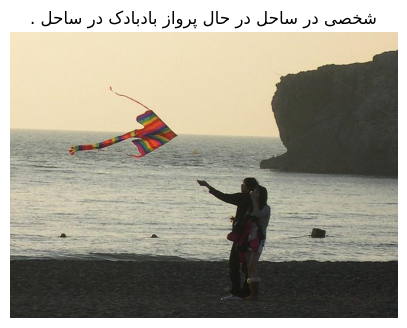

Epoch [19] Average Training Loss: 4.0202 Average Training BLEU: 0.0262 Teacher Forcing Probability: 0.6399999999999997
Epoch [19] Average Validation Loss: 4.5916 Average Validation BLEU: 0.0181 Teacher Forcing Probability: 0.6399999999999997


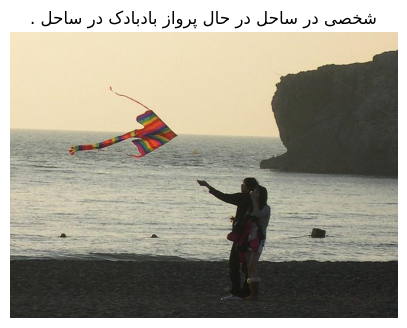

Epoch [20] Average Training Loss: 4.0202 Average Training BLEU: 0.0267 Teacher Forcing Probability: 0.6199999999999997
Epoch [20] Average Validation Loss: 4.6796 Average Validation BLEU: 0.0182 Teacher Forcing Probability: 0.6199999999999997


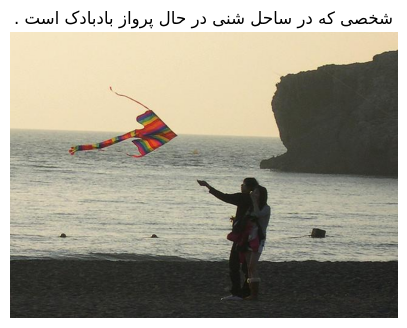

Epoch [21] Average Training Loss: 4.0554 Average Training BLEU: 0.0266 Teacher Forcing Probability: 0.5999999999999996
Epoch [21] Average Validation Loss: 4.6676 Average Validation BLEU: 0.0177 Teacher Forcing Probability: 0.5999999999999996


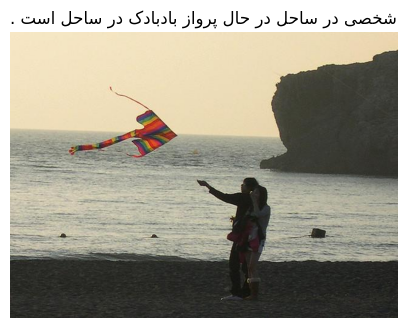

Early stopping epoch: 21


In [ ]:
epochs = 50
lr = 1e-2
weight_decay = 1e-5

vocab_size = len(tokenizer.dictionary)
embed_dim = 300
decoder_dim = 512
encoder_dim = features_shape[-1]
attention_dim = 512
model = ImageCaptioningModelSceduledSampling(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.98)
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.dictionary[special_tokens.Pad])

hist = train_ss(model, train_loader, val_loader, val_dataset, tokenizer, criterion, optimizer, epochs, 'checkpoint_scheduled_sampling.pth', device, scheduler, True, 1)

In [ ]:
model.eval()
! cp 'checkpoint_scheduled_sampling.pth' '/content/drive/MyDrive/Colab/NNDL/CAe/Part2/Models/'

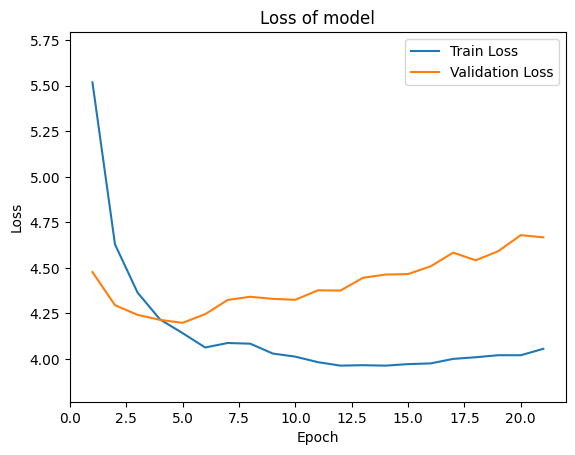

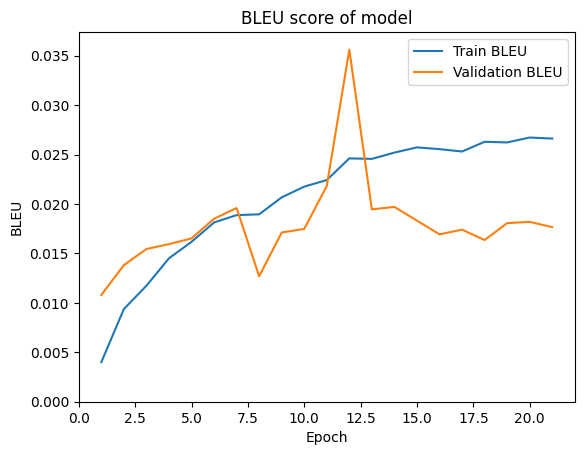

In [ ]:
plot_history(hist)

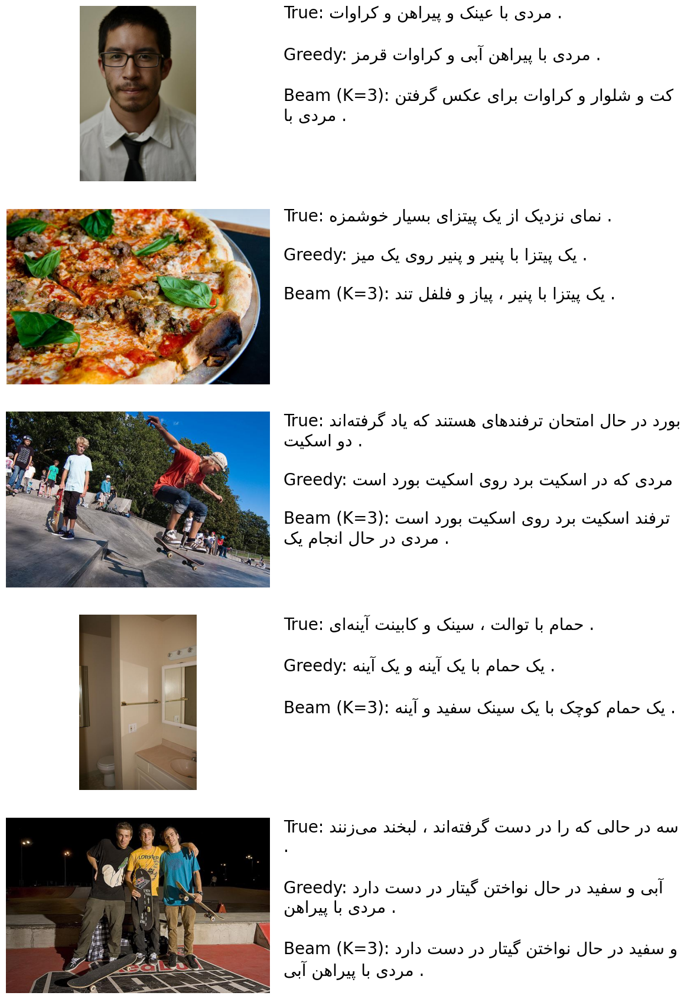

In [ ]:
beam_width = 3
nsample = 5
max_new_tokens = tokenizer.context_length
plot_generations(model, tokenizer, beam_width, nsample, test_dataset, max_new_tokens)

In [ ]:
evaluate(model, tokenizer, test_loader, beam_width, max_new_tokens)

,BLEU-1,BLEU-2,BLEU-3,BLEU-4
Greedy,0.304765,0.153921,0.087267,0.049145
Beam K = 3,0.246133,0.127750,0.075998,0.045121


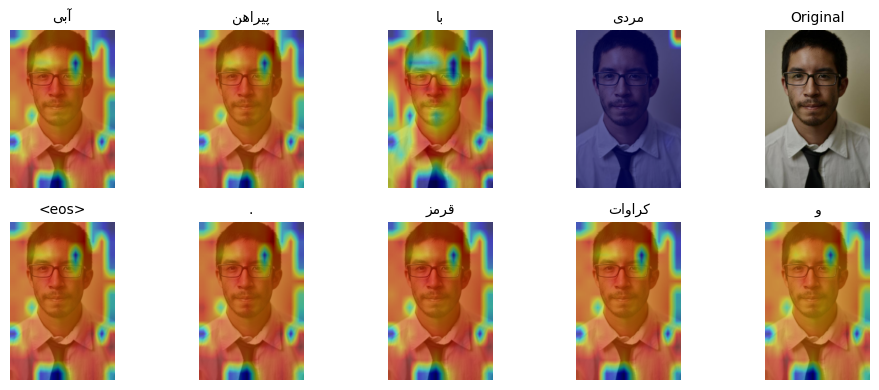

In [ ]:
show_attn_maps(0,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

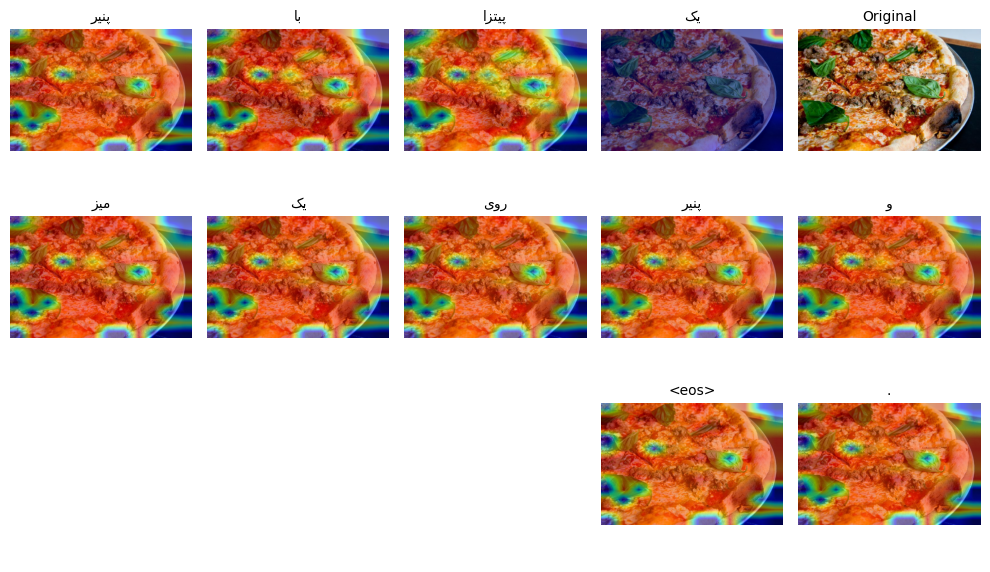

In [ ]:
show_attn_maps(1,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

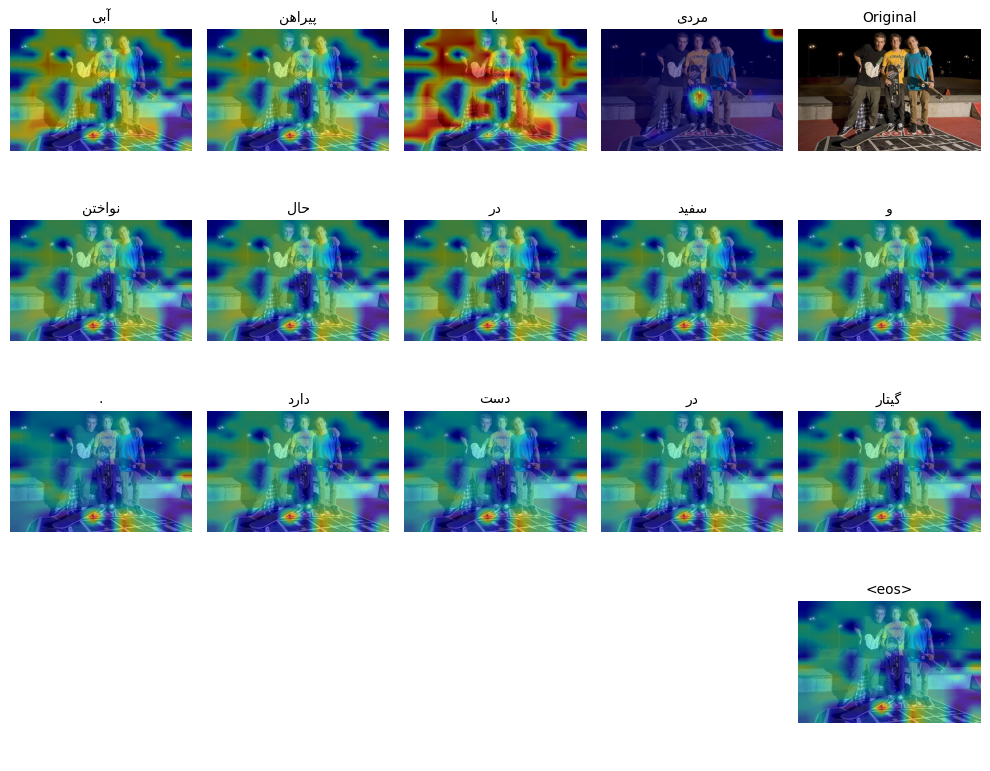

In [ ]:
show_attn_maps(4,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

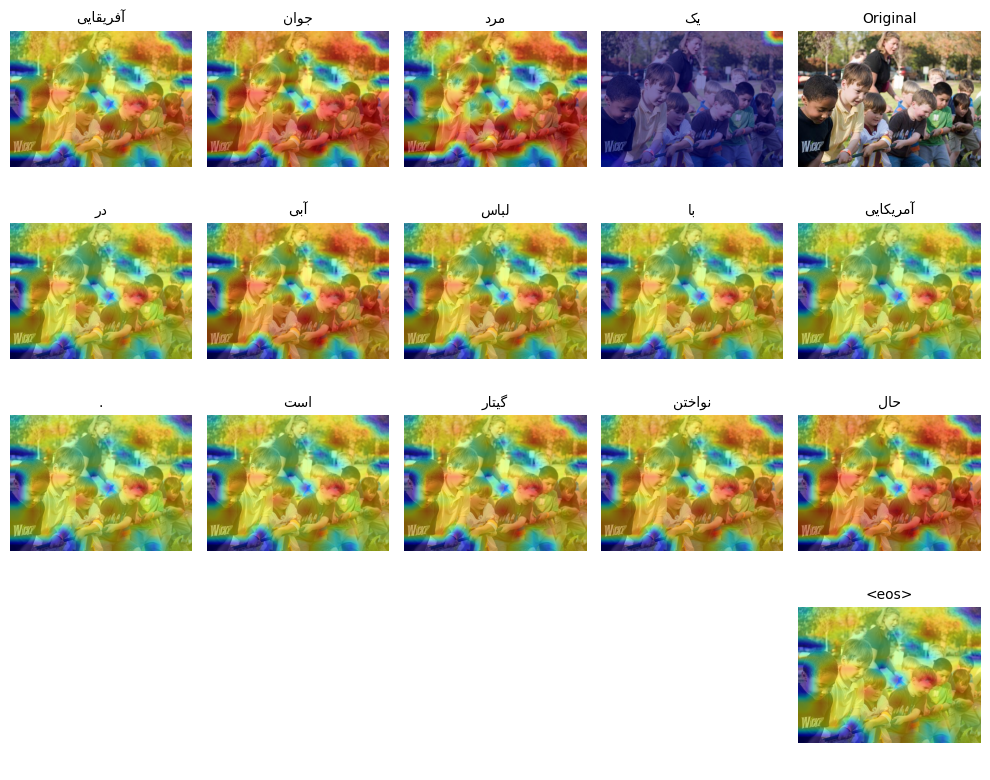

In [ ]:
show_attn_maps(9,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

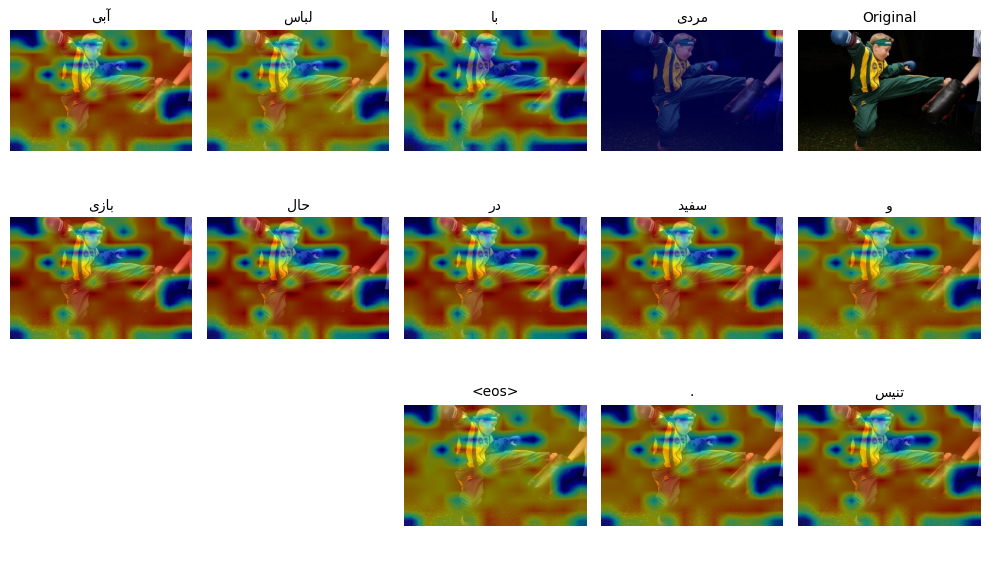

In [ ]:
show_attn_maps(10,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet')

# <a id='toc6_'></a>[Scaled Dot-Product Attention](#toc0_)

In [28]:
class Attention(nn.Module):
    def __init__(self, encoder_dim, decoder_dim, attention_dim):
        super().__init__()
        self.scale = attention_dim ** 0.5
        self.ln_q = nn.LayerNorm(decoder_dim)
        self.ln_kv = nn.LayerNorm(encoder_dim)

        self.q_proj = nn.Linear(decoder_dim, attention_dim)
        self.k_proj = nn.Linear(encoder_dim, attention_dim)

        self.softmax = nn.Softmax(dim=-1)
        self.beta_layer = nn.Linear(decoder_dim, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, features, h):
        h = self.ln_q(h)
        features = self.ln_kv(features)

        Q = self.q_proj(h).unsqueeze(1)
        K = self.k_proj(features)
        V = features

        scores = torch.bmm(Q, K.transpose(1, 2)) / self.scale
        alpha = self.softmax(scores)

        context = torch.bmm(alpha, V).squeeze(1)
        beta = self.sigmoid(self.beta_layer(h))
        context = beta * context

        return context, alpha.squeeze(1)

dummy_image = torch.randn(1,3,input_size,input_size).to(device)
dummy_caption = torch.randint(0, 100, (1,42)).long().to(device)
model_summary = summary(ImageCaptioningModel(len(tokenizer.dictionary), 300, 512, features_shape[-1], 512).to(device), input_data=(dummy_image, dummy_caption))
print_number_of_params(model_summary)

Total params: 28388996
Trainable params: 10840380
Non-trainable params: 17548616


Epoch [1] Average Training Loss: 5.5375 Average Training BLEU: 0.0028
Epoch [1] Average Validation Loss: 4.0013 Average Validation BLEU: 0.0074


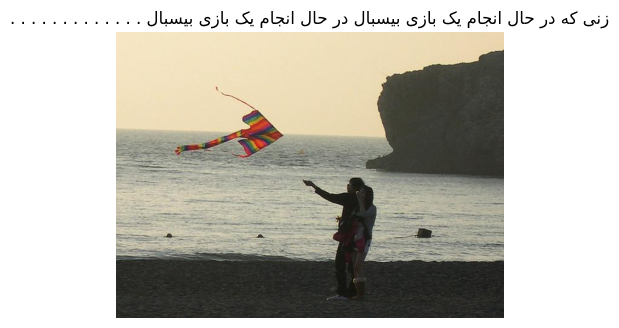

Epoch [2] Average Training Loss: 4.3857 Average Training BLEU: 0.0071
Epoch [2] Average Validation Loss: 3.7066 Average Validation BLEU: 0.0133


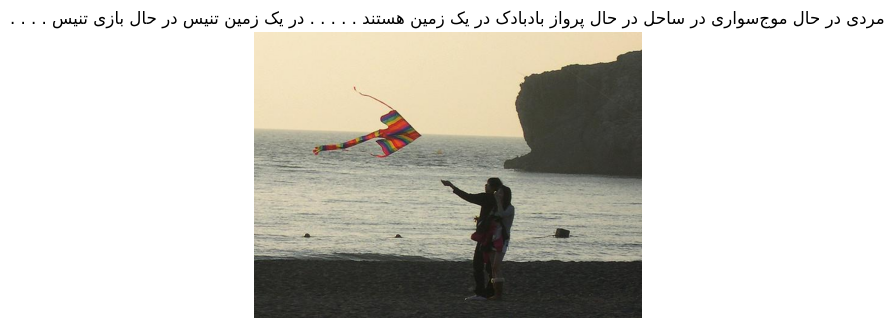

Epoch [3] Average Training Loss: 4.0057 Average Training BLEU: 0.0100
Epoch [3] Average Validation Loss: 3.5561 Average Validation BLEU: 0.0165


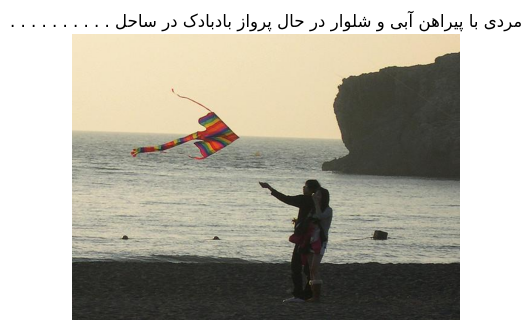

Epoch [4] Average Training Loss: 3.7589 Average Training BLEU: 0.0128
Epoch [4] Average Validation Loss: 3.5108 Average Validation BLEU: 0.0166


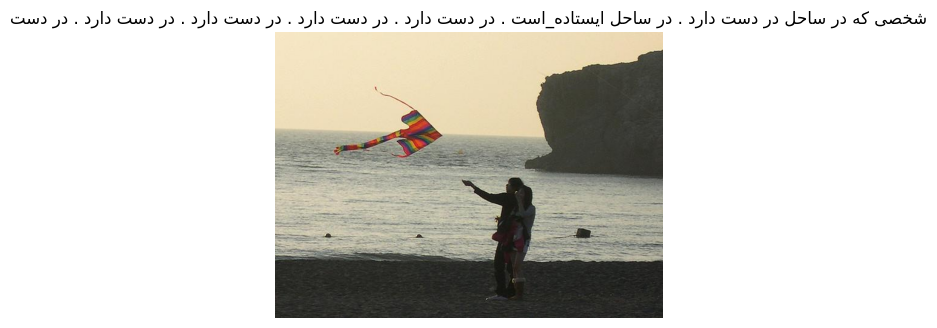

Epoch [5] Average Training Loss: 3.5849 Average Training BLEU: 0.0149
Epoch [5] Average Validation Loss: 3.4314 Average Validation BLEU: 0.0202


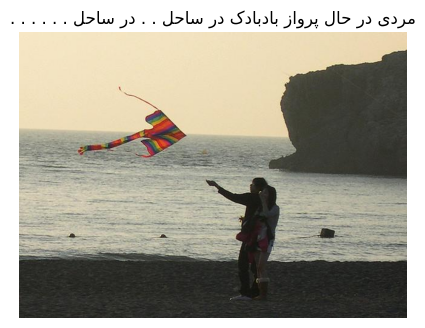

Epoch [6] Average Training Loss: 3.4525 Average Training BLEU: 0.0173
Epoch [6] Average Validation Loss: 3.4028 Average Validation BLEU: 0.0213


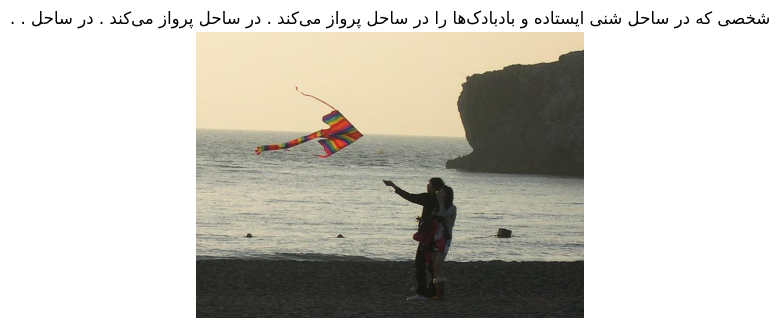

Epoch [7] Average Training Loss: 3.3555 Average Training BLEU: 0.0187
Epoch [7] Average Validation Loss: 3.3921 Average Validation BLEU: 0.0212


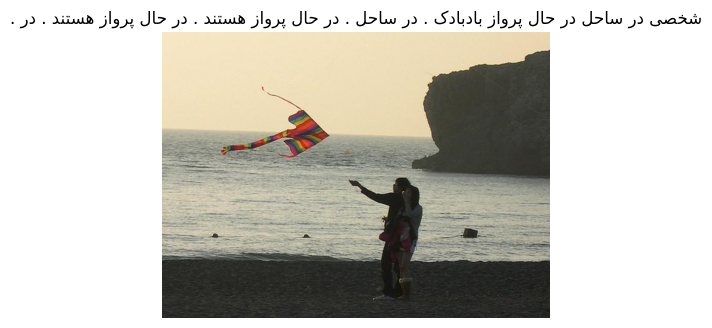

Epoch [8] Average Training Loss: 3.2623 Average Training BLEU: 0.0213
Epoch [8] Average Validation Loss: 3.3934 Average Validation BLEU: 0.0203


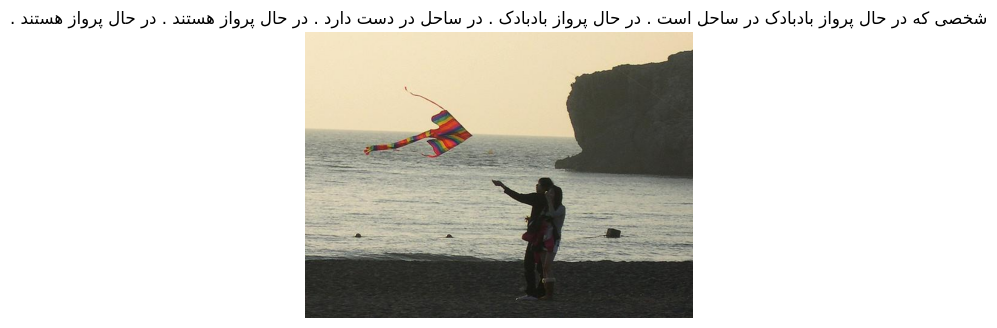

Epoch [9] Average Training Loss: 3.1921 Average Training BLEU: 0.0227
Epoch [9] Average Validation Loss: 3.3860 Average Validation BLEU: 0.0227


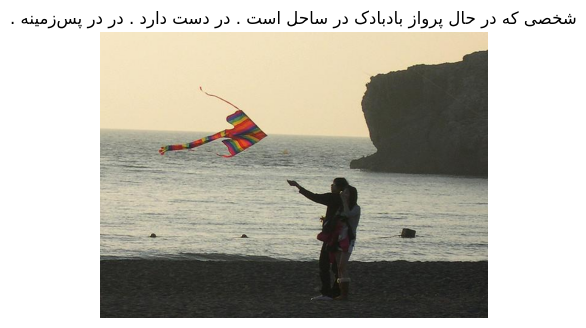

Epoch [10] Average Training Loss: 3.1425 Average Training BLEU: 0.0250
Epoch [10] Average Validation Loss: 3.3670 Average Validation BLEU: 0.0244


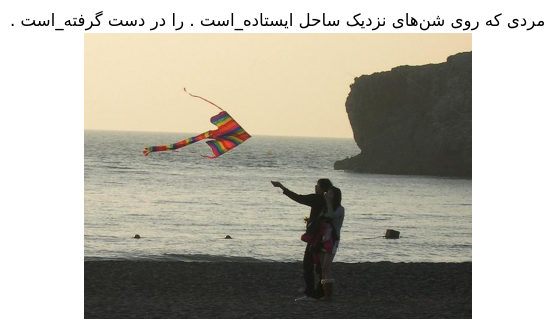

Epoch [11] Average Training Loss: 3.0806 Average Training BLEU: 0.0269
Epoch [11] Average Validation Loss: 3.3996 Average Validation BLEU: 0.0304


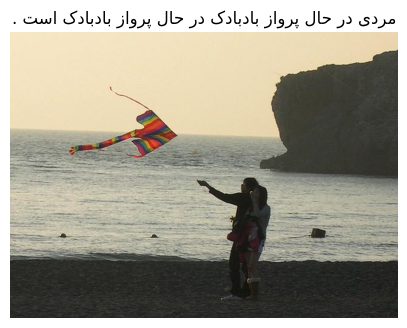

Epoch [12] Average Training Loss: 3.0246 Average Training BLEU: 0.0311
Epoch [12] Average Validation Loss: 3.4339 Average Validation BLEU: 0.0221


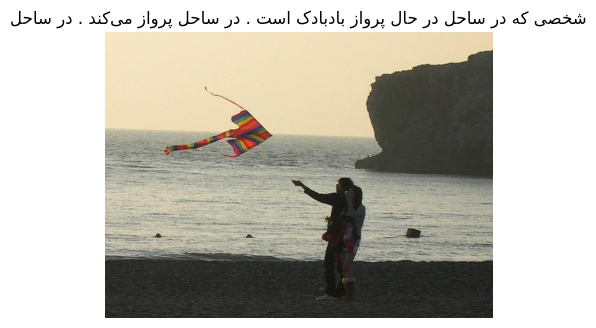

Epoch [13] Average Training Loss: 2.9814 Average Training BLEU: 0.0287
Epoch [13] Average Validation Loss: 3.4256 Average Validation BLEU: 0.0253


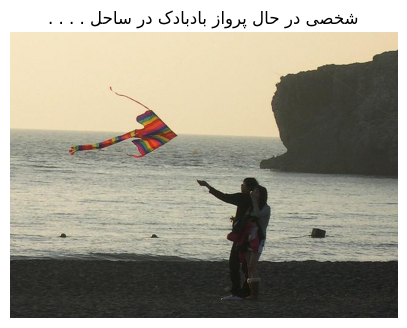

Epoch [14] Average Training Loss: 2.9273 Average Training BLEU: 0.0307
Epoch [14] Average Validation Loss: 3.4334 Average Validation BLEU: 0.0276


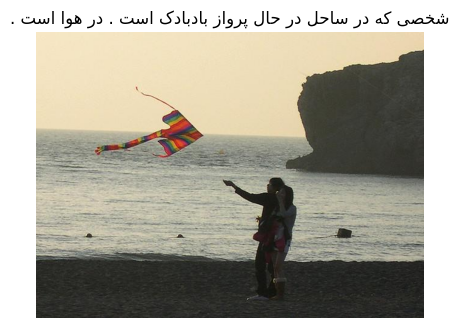

Epoch [15] Average Training Loss: 2.8931 Average Training BLEU: 0.0363
Epoch [15] Average Validation Loss: 3.4351 Average Validation BLEU: 0.0238


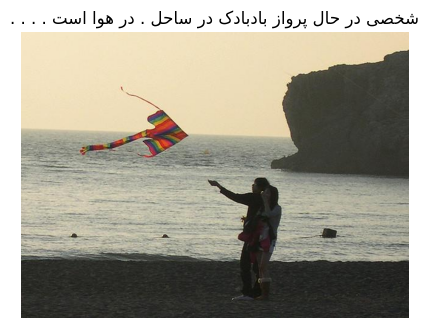

Epoch [16] Average Training Loss: 2.8442 Average Training BLEU: 0.0347
Epoch [16] Average Validation Loss: 3.4641 Average Validation BLEU: 0.0270


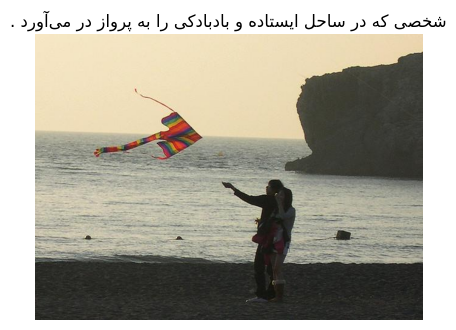

Epoch [17] Average Training Loss: 2.8069 Average Training BLEU: 0.0349
Epoch [17] Average Validation Loss: 3.4914 Average Validation BLEU: 0.0246


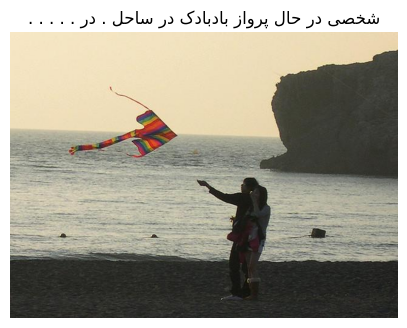

Epoch [18] Average Training Loss: 2.7593 Average Training BLEU: 0.0361
Epoch [18] Average Validation Loss: 3.4717 Average Validation BLEU: 0.0286


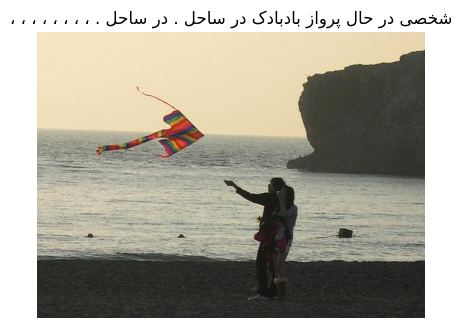

Epoch [19] Average Training Loss: 2.7133 Average Training BLEU: 0.0387
Epoch [19] Average Validation Loss: 3.4938 Average Validation BLEU: 0.0240


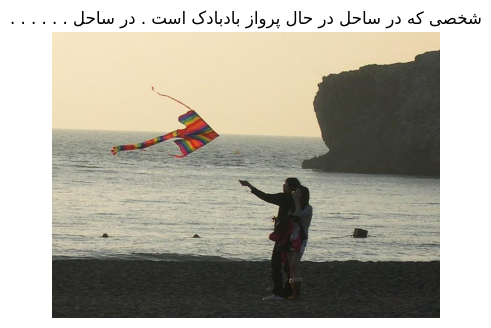

Epoch [20] Average Training Loss: 2.6735 Average Training BLEU: 0.0428
Epoch [20] Average Validation Loss: 3.5365 Average Validation BLEU: 0.0246


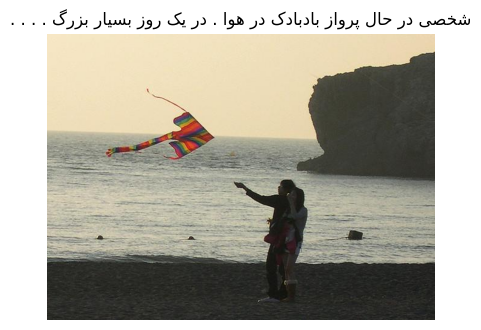

Epoch [21] Average Training Loss: 2.6414 Average Training BLEU: 0.0409
Epoch [21] Average Validation Loss: 3.5288 Average Validation BLEU: 0.0243


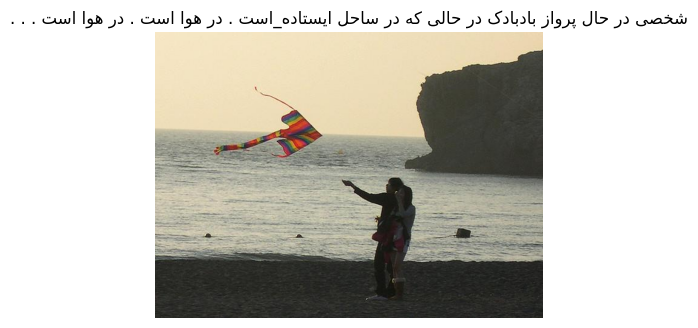

Early stopping epoch: 21


In [ ]:
epochs = 50
lr = 1e-2
weight_decay = 1e-5

vocab_size = len(tokenizer.dictionary)
embed_dim = 300
decoder_dim = 512
encoder_dim = features_shape[-1]
attention_dim = 512
model = ImageCaptioningModel(vocab_size, embed_dim, decoder_dim, encoder_dim, attention_dim)

optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.98)
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.dictionary[special_tokens.Pad])

hist = train(model, train_loader, val_loader, val_dataset, tokenizer, criterion, optimizer, epochs, 'scaled_dot_prod_attn.pth', device, scheduler, True, 0)

In [ ]:
model.eval()
! cp 'scaled_dot_prod_attn.pth' '/content/drive/MyDrive/Colab/NNDL/CAe/Part2/Models/scaled_dot_prod_attn3.pth'

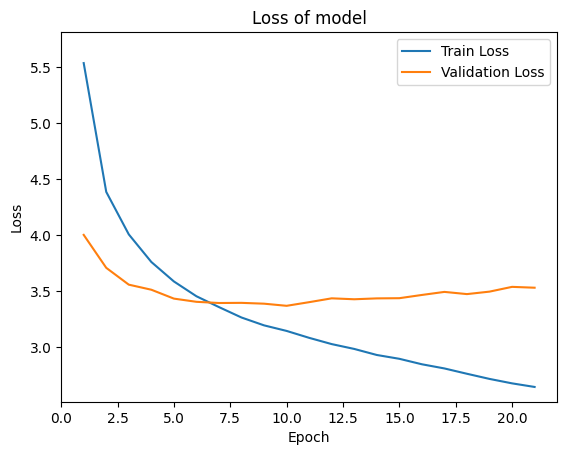

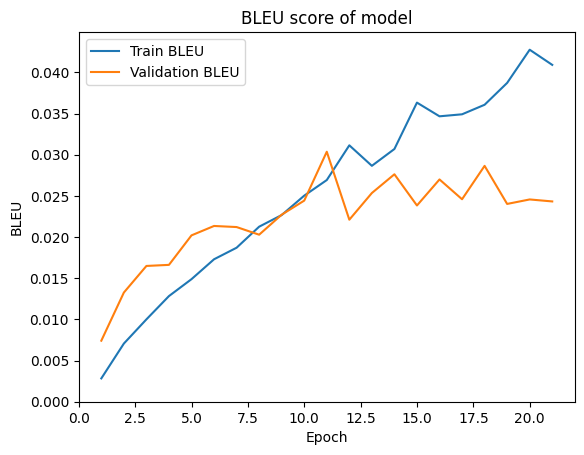

In [ ]:
plot_history(hist)

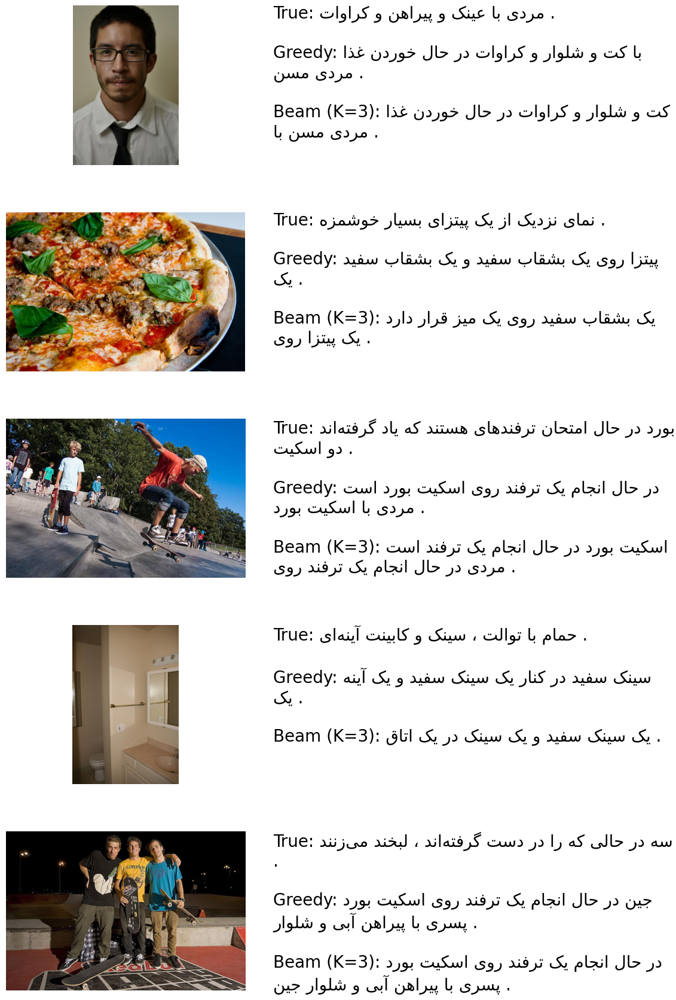

In [37]:
beam_width = 3
nsample = 5
max_new_tokens = tokenizer.context_length
plot_generations(model, tokenizer, beam_width, nsample, test_dataset, max_new_tokens)

In [32]:
beam_width = 3
max_new_tokens = tokenizer.context_length
evaluate(model, tokenizer, test_loader, beam_width, max_new_tokens)

,BLEU-1,BLEU-2,BLEU-3,BLEU-4
Greedy,0.255505,0.128975,0.073439,0.043177
Beam K = 3,0.246227,0.125683,0.072289,0.043669


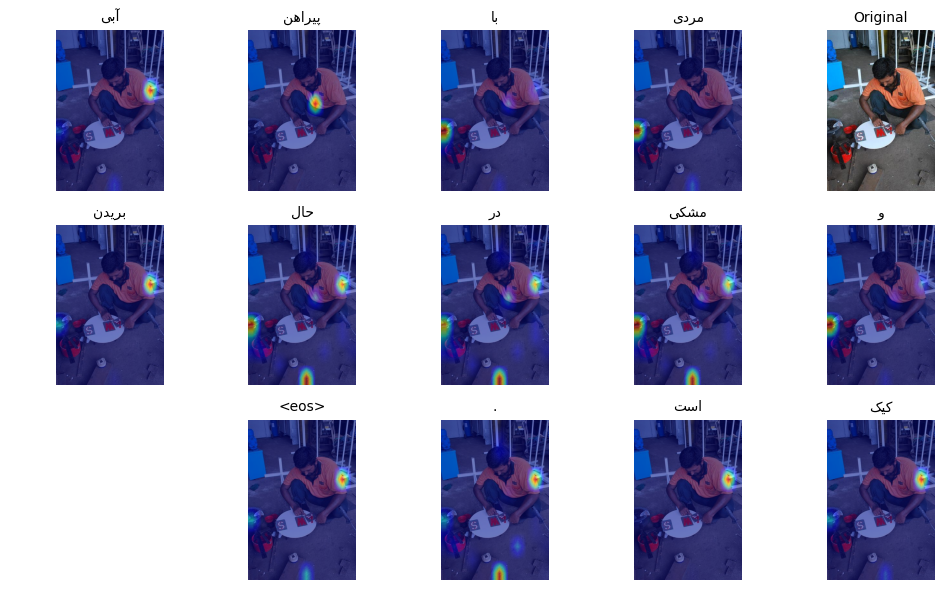

In [34]:
alpha_size = int(np.sqrt(features_shape[1]))
show_attn_maps(11,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet',generate_greedy=False)

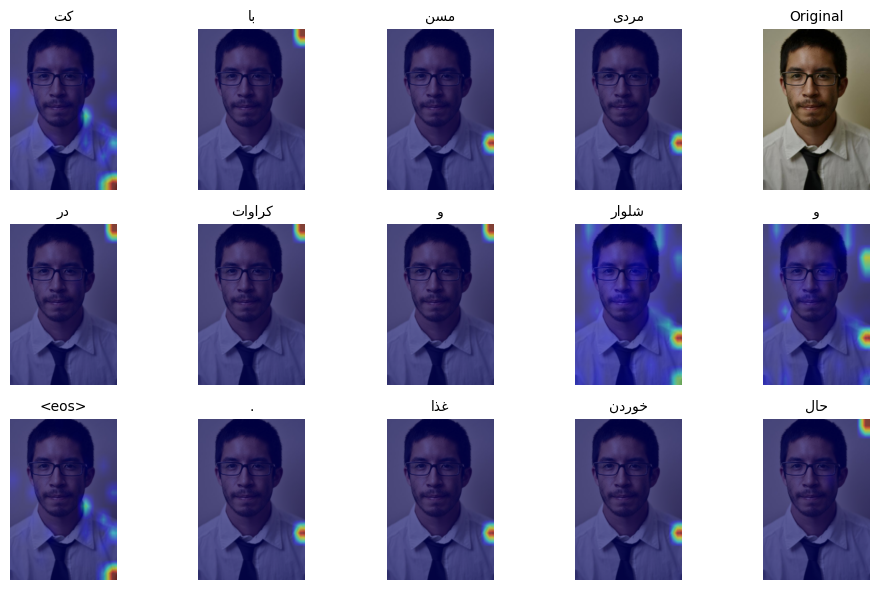

In [36]:
show_attn_maps(0,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet',generate_greedy=False)

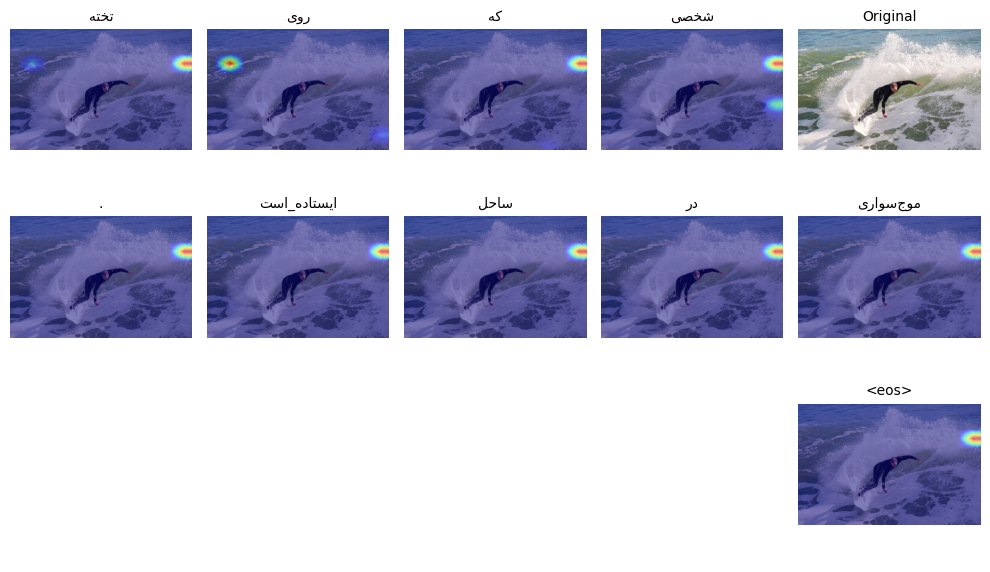

In [61]:
show_attn_maps(26,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet',generate_greedy=False)

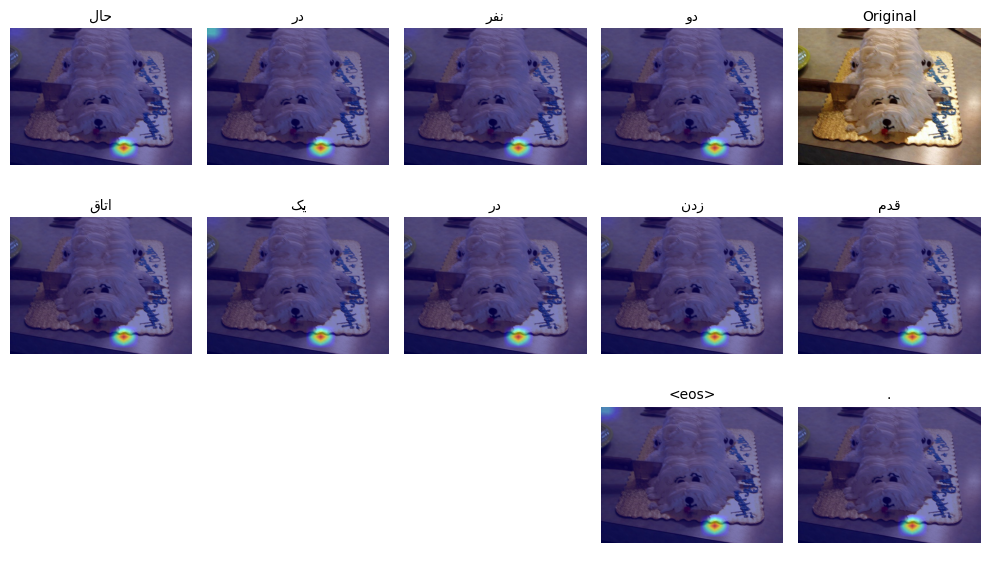

In [62]:
show_attn_maps(27,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet',generate_greedy=False)

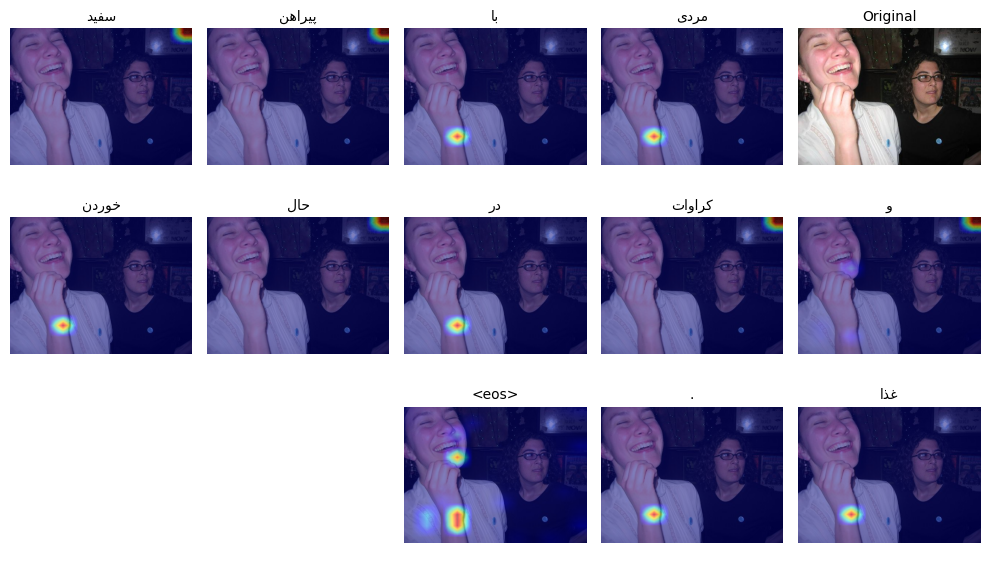

In [ ]:
show_attn_maps(15,test_dataset,model,tokenizer,max_new_tokens,alpha_size,'jet',generate_greedy=False)